<h1>Introduction</h1>

<p>This project focuses on analyzing <strong style='color: red'>Dublin house prices</strong> and using machine learning models for prediction. The work was completed at the <strong style='color: red'>end of July 2024</strong>.</p>

<h4>Data Source</h4>
<p>The data sources are listed below. Due to privacy concerns, the web crawling code will not be shared, but the publicly acquired data will be available.</p>
<ul>
    <li><a href='https://www.daft.ie/property-for-sale/dublin/houses'>Daft.ie</a> for house-related features.</li>
    <li><a href='https://www.gov.ie/en/directory/category/495b8a-schools/'>Gov.ie</a> for information on primary, post-primary, and special education schools.</li>
    <li>Supermarket locations from the official websites or mobile apps of Dunnes, Lidl, Aldi, and Supervalu.</li>
    <li><a href='https://www.dublinpublictransport.ie/s/dublin-rail-map.pdf'>Dublin Public Transport</a> for railway (DART, train, and LUAS) stops. OCR techniques were used for data extraction.</li>
    <li><a href='https://www2.hse.ie/services/find-a-gp/'>HSE</a> for GP locations.</li>
</ul>
<p>Some data sources lacked geolocation information. To address this, Google Geolocation API was used to fill in the missing data, and systematic verification was conducted manually.</p>

<h4>Content</h4>
<ol>
    <li>Load Data</li>
    <li>Feature Engineering</li>
    <ol>
        <li>EDA (Exploratory Data Analysis)</li>
        <ol>
            <li>Basic Statistics 1 (Price, Bedroom and Bathroom)</li>
            <li>Basic Statistics 2 (Area, BER, Types, Location and Property Views)</li>
            <li>Basic Statistics 3 (District Statistics)</li>
            <li>New & Old House Geolocation</li>
            <li>Rail, School, Supermarket and GP Statistics</li>
            <li>House Geolocation with Rail</li>
            <li>House Geolocation with Surrounding Facilities</li>
            <li>Facilities Mean Distance & Unit Number to Each House</li>
        </ol>
        <li>Data Preprocessing</li>
             <ol>
                 <li>Dependency / Correlation Analysis</li>
                 <li>Distribution and Histograms</li>
                 <li>Data Imputation</li>
                 <ol>
                     <li>Data Imputation Strategies</li>
                     <li>KNNImputer</li>
                 </ol>
                 <li>Train & Test Split</li>
                 <li>Feature Split</li>
                 <li>Dimensionality Reduction</li>
                 <ol>
                     <li>PCA with Explained Variance</li>
                     <li>PCA Loadings</li>
                 </ol>
             </ol>
        <li>Feature Engineering Pipeline</li>
    </ol>
    <li>Modeling</li>
    <ol>
        <li>Linear Model (ElasticNet)</li>
        <li>Decision Tree (Decision Tree)</li>
        <li>Random Forest</li>
        <li>Support Vector Regressor (SVR)</li>
        <li>Stacking</li>
        <li>Model Metrics Summary</li>
        <li>Overview</li>
    </ol>
    <li>Evaluation and Explainability</li>
    <ol>
        <li>Model Evaluation</li>
        <ol>
            <li>Permutation Importance</li>
            <li>Model Coefficients</li>
            <li>Residual Plot</li>
        </ol>
        <li>Model Explainability with SHAP (SHapley Additive exPlanations)</li>
        <ol>
            <li>Feature Summary Plot</li>
            <li>Mean Absolute Price Difference by 10K Bins</li>
            <li>Test Example</li>
        </ol>
    </ol>
</ol>

# Load Data

In [1]:
import pandas as pd
import numpy as np
import locale
from datetime import datetime
from sklearn.preprocessing import LabelEncoder
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from collections import Counter
from math import pi
from scipy.stats import gaussian_kde
from scipy import stats

def format_euros(input_str):
    
    # Set locale to a European format (e.g., en_US.UTF-8 for English, United States)
    locale.setlocale(locale.LC_ALL, 'en_US.UTF-8')
    result = np.NaN
    
    try:
        # Remove the currency symbol and any extra spaces
        cleaned_str = input_str.replace('€', '').strip()
        
        # Convert the cleaned string to a float
        number = locale.atof(cleaned_str)
        
        # Convert to an integer
        result = int(number)
    except:
        pass
    return result


def format_general_types(input_str):

    result = np.NaN
    try:
        quantity, unit = input_str.split(' ')
        result = int(quantity)
    except:
        pass
    return result


def formate_BER(df_series):
    
    """
    Building Energy Rating (BER), order from good to bad
    ['A1', 'A2', 'A3', 'B1', 'B2', 'B3', 'C1', 'C2', 'C3', 'D1', 'D2', 'E1', 'E2', 'F', 'G', 'berexempt', nan]
    
    How is your BER calculated?
    
    A BER assesses the amount of energy your home uses for things such as:
    Heating the hot water
    Heating the rooms
    Ventilation
    Lighting
    """
    
    ber_list = [f"{letter}{number}" for letter in 'ABC' for number in range(1, 4)] + \
            [f"{letter}{number}" for letter in 'DE' for number in range(1, 3)] + ['F', 'G', 'berexempt', np.NaN]
    le = LabelEncoder()
    le.fit(ber_list)
    df_series = [value if value in ber_list else np.NaN for value in df_series]
    return le.transform(df_series)

def formate_BER_inverse(df_series):
    ber_list = [f"{letter}{number}" for letter in 'ABC' for number in range(1, 4)] + \
            [f"{letter}{number}" for letter in 'DE' for number in range(1, 3)] + ['F', 'G', 'berexempt', np.NaN]
    le = LabelEncoder()
    le.fit(ber_list)
    return le.inverse_transform(df_series)

def extract_district_code(address):
    
    last_part = address.split(',')[-1].strip()
    district = np.NaN
    
    if len(last_part.replace(' ', '')) == 7 and last_part.replace(' ', '')[1].isdigit():
        district = last_part[:3].upper()
    elif last_part in ['Co. Dublin', 'Co Dublin']:
        district = 'Co. Dublin'
    elif 'dublin' in last_part.lower():
        district_number = last_part.lower().split(' ')[-1]
        district = 'D0' + district_number if len(district_number) == 1 else 'D' + district_number
        district = district.upper()
    else:
        district = np.NaN
    return district

def extract_property_unit(property_overview):
    if pd.isna(property_overview):
        return 1
    else:
        return int(property_overview.split(' ')[0])

process_id = 1

source = pd.read_csv('/Users/xingdawang/Desktop/Dublin_house/raw_data/daft_with_loc.csv')
original_data_length = len(source)

# remove new house container pages
print(f'Load data and make some cleaning work:')
print(f'{process_id}. remove new house container records')
process_id += 1
source = source[pd.notna(source['new_house'])]

# format euros, string starts '€' first is the only validated, the others will be np.nan
print(f'{process_id}. format euros')
process_id += 1
source['price'] = source['price'].apply(lambda x: format_euros(x))

# format bed_number, bath_number, area and ber_epi
print(f'{process_id}. format bed_number, bath_number, area and ber_epi')
process_id += 1
for feature in ['bed_number', 'bath_number', 'area', 'ber_epi']:
    source[feature] = source[feature].apply(lambda x: format_general_types(x))

# format BER
print(f'{process_id}. format BER')
process_id += 1
source['ber'] = formate_BER(source['ber'])

# format entered_or_renewed
print(f'{process_id}. format entered_or_renewed')
process_id += 1
source['entered_or_renewed'] = pd.to_datetime(source['entered_or_renewed'], dayfirst=True)
source['entered_or_renewed_days_ago'] = (datetime.today() - source['entered_or_renewed']).dt.days
source.drop(columns=['entered_or_renewed'], inplace=True)

# format property_views
print(f'{process_id}. format property_views')
process_id += 1
source = source[pd.notna(source['property_views'])] # network glitch
source['property_views'] = source['property_views'].apply(lambda x: int(x.replace(',', '')))

# format latitude and longitude
print(f'{process_id}. format latitude and longitude, mannually found several location missing or wrong, revised with Google Map')
process_id += 1

source.at[202, 'lat'], source.at[202, 'lng'] = (53.419568, -6.2074886)
source.at[429, 'lat'], source.at[429, 'lng'] = (53.3856708, -6.0591594)
source.at[552, 'lat'], source.at[552, 'lng'] = (53.3216959, -6.4201146)
source.at[963, 'lat'], source.at[963, 'lng'] = (53.3072124, -6.212546)
source.at[1212, 'lat'], source.at[1212, 'lng'] = (53.3185853, -6.3993605)
source.at[1395, 'lat'], source.at[1395, 'lng'] = (53.3486719, -6.3516564)
source.at[1573, 'lat'], source.at[1573, 'lng'] = (53.3527054, -6.3006063)
source.at[1596, 'lat'], source.at[1596, 'lng'] = (53.3144037, -6.2330276)
source.at[1845, 'lat'], source.at[1845, 'lng'] = (53.221606, -6.1451435)
source.at[1921, 'lat'], source.at[1921, 'lng'] = (53.3820369, -6.0722433)
source.at[2123, 'lat'], source.at[2123, 'lng'] = (53.4032275, -6.2119072)



# extract district area from address
print(f'{process_id}. extract district code from address')
process_id += 1
source['district'] = source['address'].apply(lambda x: extract_district_code(x))

# extract property unit from property overview
print(f'{process_id}. extract property unit from property overview')
process_id += 1
source['property_unit'] = source['property_overview'].apply(lambda x: extract_property_unit(x))
source.drop(columns=['property_overview'], inplace=True)

print(f'\nOriginal data source records: {original_data_length}')
print(f'Formated data source records: {len(source)}')
total_houses = source['property_unit'].sum()
print(f'Total houses: {total_houses}')
source.head()

Load data and make some cleaning work:
1. remove new house container records
2. format euros
3. format bed_number, bath_number, area and ber_epi
4. format BER
5. format entered_or_renewed
6. format property_views
7. format latitude and longitude, mannually found several location missing or wrong, revised with Google Map
8. extract district code from address
9. extract property unit from property overview

Original data source records: 2135
Formated data source records: 2088
Total houses: 3070


,url,address,price,bed_number,bath_number,area,house_type,new_house,ber,ber_epi,property_views,description,features,lat,lng,entered_or_renewed_days_ago,district,property_unit
0,https://www.daft.ie/for-sale/semi-detached-hou...,"The Glade, Glenomena Grove, Booterstown, Boote...",995000.0,4.0,2.0,112.0,Semi-D,NO,1,NaN,2671,Janet Carroll Estate Agents are excited to int...,Property Features\nBer A2 Rating.\nSeparate ga...,53.308320,-6.210344,8.0,A94,1
1,https://www.daft.ie/for-sale/terraced-house-30...,"30 Northumberland Avenue, Dun Laoghaire, Co. D...",1250000.0,7.0,5.0,265.0,Terrace,NO,14,NaN,7468,Victorian two storey over basement period home...,Property Features\nVictorian period residence ...,53.289262,-6.135681,7.0,A96,1
2,https://www.daft.ie/for-sale/terraced-house-7-...,"7 Raglan Road, Dublin 4, Co. Dublin, D04V0N0",3800000.0,5.0,4.0,406.0,Terrace,NO,16,NaN,10206,A classic Victorian family home with a west fa...,Property Features\nA classic Victorian townhou...,53.330982,-6.238535,10.0,D04,1
3,https://www.daft.ie/for-sale/detached-house-gl...,"Glasthule Lodge, Adelaide Road, Glenageary, Co...",4250000.0,4.0,3.0,336.0,Detached,NO,15,NaN,17778,Bohan Hyland & Associates are delighted to pre...,NaN,53.282167,-6.123883,9.0,A96,1
4,https://www.daft.ie/for-sale/terraced-house-46...,"46 Upper Grand Canal Street, Ballsbridge, Dubl...",1295000.0,4.0,3.0,154.0,Terrace,NO,9,NaN,23446,Quillsen is delighted to present to the market...,Property Features\nBeautifully presented four ...,53.337636,-6.235015,7.0,D04,1


# Feature Engineering

## EDA (Exploratory Data Analysis)

#### Basic Statistics 1 (Price, Bedroom and Bathroom)

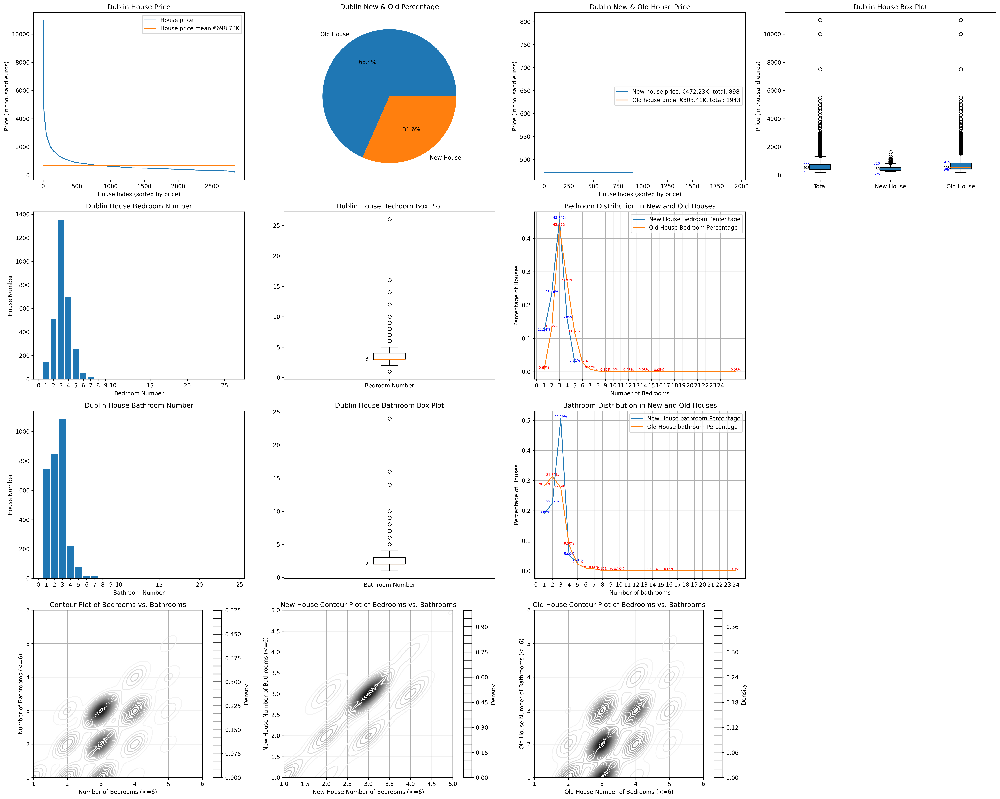

In [2]:
plt.figure(figsize=(25, 20), dpi=300)

# plot 1:
plt.subplot(4, 4, 1)

# each house price, unit in thousand euros
price_list = [
    row['price'].astype(int) / 1000
    for _, row in source[['price', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

# line plot for each house
x = np.arange(len(price_list))
y = sorted(price_list, reverse=True)

# mean price
y_mean = [np.mean(price_list)] * len(price_list)

plt.plot(x, y, label='House price')
plt.plot(x, y_mean, label=f'House price mean €{np.mean(price_list):.2f}K')
plt.title('Dublin House Price')
plt.xlabel('House Index (sorted by price)')
plt.ylabel('Price (in thousand euros)')
plt.legend()

# plot 2:
plt.subplot(4, 4, 2)

# mean price for new & old house
new_house = source[source['new_house'] == 'YES']
old_house = source[source['new_house'] == 'NO']
new_house_price_list = [
    row['price'].astype(int) / 1000
    for _, row in new_house[['price', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_price_list = [
    row['price'].astype(int) / 1000
    for _, row in old_house[['price', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
x_mean_new_house = np.arange(len(new_house_price_list))
x_mean_old_house = np.arange(len(old_house_price_list))
y_mean_new_house = [np.mean(new_house_price_list)] * len(new_house_price_list)
y_mean_old_house = [np.mean(old_house_price_list)] * len(old_house_price_list)

labels = 'Old House', 'New House'
sizes = [len(y_mean_old_house), len(y_mean_new_house)]
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('Dublin New & Old Percentage')


# plot 3:
plt.subplot(4, 4, 3)


plt.title('Dublin New & Old House Price')
plt.xlabel('House Index (sorted by price)')
plt.ylabel('Price (in thousand euros)')
plt.plot(x_mean_new_house, y_mean_new_house, label=f'New house price: €{np.mean(y_mean_new_house):.2f}K, total: {len(y_mean_new_house)}')
plt.plot(x_mean_old_house, y_mean_old_house, label=f'Old house price: €{np.mean(y_mean_old_house):.2f}K, total: {len(y_mean_old_house)}')
plt.legend()

# plot 4:
plt.subplot(4, 4, 4)
data = [price_list, new_house_price_list, old_house_price_list]
labels = ['Total', 'New House', 'Old House']
box = plt.boxplot(data, tick_labels=labels, patch_artist=True)

plt.title('Dublin House Box Plot')
plt.ylabel('Price (in thousand euros)')

# Offset to move the text higher
offset = 0.045 * max(map(max, data))  # Adjust this factor as needed based on the data scale

# Annotate median and percentiles
for i, boxplot in enumerate(box['medians']):
    # Median
    median_value = boxplot.get_ydata()[0]
    plt.text(i + 0.85, median_value, f'{median_value:,.0f}', va='center', ha='right', fontsize=6, color='black')

for i, boxplot in enumerate(box['boxes']):
    # First (Q1) and third (Q3) quartiles
    box_coords = boxplot.get_path().vertices
    q1 = box_coords[0, 1]
    q3 = box_coords[2, 1]
    plt.text(i + 0.85, q1 + offset, f'{q1:,.0f}', va='center', ha='right', fontsize=6, color='blue')
    plt.text(i + 0.85, q3 - offset, f'{q3:,.0f}', va='center', ha='right', fontsize=6, color='blue')

# plot 5:
plt.subplot(4, 4, 5)
bed_number_list = [
    row['bed_number'].astype(int)
    for _, row in source[['bed_number', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
bed_number_counter = Counter(bed_number_list)
# Sorting the Counter by key
sorted_bed_number = dict(sorted(bed_number_counter.items(), key=lambda item: item[0]))
plt.bar(height=sorted_bed_number.values(), x=sorted_bed_number.keys())
# Adding ticks from 1 to 10 on the x-axis
tick_positions = list(range(0, 11)) + [15, 20, 25]
plt.xticks(tick_positions)
plt.title('Dublin House Bedroom Number')
plt.xlabel('Bedroom Number')
plt.ylabel('House Number')

# plot 6:
plt.subplot(4, 4, 6)
box = plt.boxplot(bed_number_list, tick_labels=['Bedroom Number'])

for i, boxplot in enumerate(box['medians']):
    # Median
    median_value = boxplot.get_ydata()[0]
    plt.text(i + 0.9, median_value, f'{median_value:,.0f}', va='center', ha='right', fontsize=9, color='black')
plt.title('Dublin House Bedroom Box Plot')


# plot 7:
plt.subplot(4, 4, 7)

new_house_bed_number_list = [
    row['bed_number'].astype(int)
    for _, row in new_house[['bed_number', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_bed_number_list = [
    row['bed_number'].astype(int)
    for _, row in old_house[['bed_number', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

new_house_bed_number_counter = Counter(new_house_bed_number_list)
sorted_new_house_bed_number = dict(sorted(new_house_bed_number_counter.items(), key=lambda item: item[0]))
sorted_new_house_bed_number_index = sorted_new_house_bed_number.keys()
sorted_new_house_bed_number_percentage = [value / len(new_house_bed_number_list) for value in sorted_new_house_bed_number.values()]

old_house_bed_number_counter = Counter(old_house_bed_number_list)
sorted_old_house_bed_number = dict(sorted(old_house_bed_number_counter.items(), key=lambda item: item[0]))
sorted_old_house_bed_number_index = sorted_old_house_bed_number.keys()
sorted_old_house_bed_number_percentage = [value / len(old_house_bed_number_list) for value in sorted_old_house_bed_number.values()]

plt.plot(sorted_new_house_bed_number_index, sorted_new_house_bed_number_percentage, label='New House Bedroom Percentage')
plt.plot(sorted_old_house_bed_number_index, sorted_old_house_bed_number_percentage, label='Old House Bedroom Percentage')

# Label values on the line plot
for i, value in zip(sorted_new_house_bed_number_index, sorted_new_house_bed_number_percentage):
    plt.text(i, value, f'{value:.2%}', fontsize=6, ha='center', color='blue', va='bottom')

for i, value in zip(sorted_old_house_bed_number_index, sorted_old_house_bed_number_percentage):
    plt.text(i, value, f'{value:.2%}', fontsize=6, ha='center', color='red', va='bottom')

plt.xlabel('Number of Bedrooms')
plt.ylabel('Percentage of Houses')
plt.title('Bedroom Distribution in New and Old Houses')
plt.xticks(np.arange(0, 25))
plt.legend()
plt.grid(True)

# plot 8:
plt.subplot(4, 4, 9)

bath_number_list = [
    row['bath_number'].astype(int)
    for _, row in source[['bath_number', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
bath_number_counter = Counter(bath_number_list)
# Sorting the Counter by key
sorted_bath_number = dict(sorted(bath_number_counter.items(), key=lambda item: item[0]))
plt.bar(height=sorted_bath_number.values(), x=sorted_bath_number.keys())
# Adding ticks from 1 to 10 on the x-axis
tick_positions = list(range(0, 11)) + [15, 20, 25]
plt.xticks(tick_positions)

plt.title('Dublin House Bathroom Number')
plt.xlabel('Bathroom Number')
plt.ylabel('House Number')

# plot 9:
plt.subplot(4, 4, 10)
box = plt.boxplot(bath_number_list, tick_labels=['Bathroom Number'])

for i, boxplot in enumerate(box['medians']):
    # Median
    median_value = boxplot.get_ydata()[0]
    plt.text(i + 0.9, median_value, f'{median_value:,.0f}', va='center', ha='right', fontsize=9, color='black')
plt.title('Dublin House Bathroom Box Plot')

new_house_bath_number_list = [
    row['bath_number'].astype(int)
    for _, row in new_house[['bath_number', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_bath_number_list = [
    row['bath_number'].astype(int)
    for _, row in old_house[['bath_number', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

# plot 10:
plt.subplot(4, 4, 11)
new_house_bath_number_counter = Counter(new_house_bath_number_list)
sorted_new_house_bath_number = dict(sorted(new_house_bath_number_counter.items(), key=lambda item: item[0]))
sorted_new_house_bath_number_index = sorted_new_house_bath_number.keys()
sorted_new_house_bath_number_percentage = [value / len(new_house_bath_number_list) for value in sorted_new_house_bath_number.values()]

old_house_bath_number_counter = Counter(old_house_bath_number_list)
sorted_old_house_bath_number = dict(sorted(old_house_bath_number_counter.items(), key=lambda item: item[0]))
sorted_old_house_bath_number_index = sorted_old_house_bath_number.keys()
sorted_old_house_bath_number_percentage = [value / len(old_house_bath_number_list) for value in sorted_old_house_bath_number.values()]

plt.plot(sorted_new_house_bath_number_index, sorted_new_house_bath_number_percentage, label='New House bathroom Percentage')
plt.plot(sorted_old_house_bath_number_index, sorted_old_house_bath_number_percentage, label='Old House bathroom Percentage')

# Label values on the line plot
for i, value in zip(sorted_new_house_bath_number_index, sorted_new_house_bath_number_percentage):
    plt.text(i, value, f'{value:.2%}', fontsize=6, ha='center', color='blue', va='bottom')

for i, value in zip(sorted_old_house_bath_number_index, sorted_old_house_bath_number_percentage):
    plt.text(i, value, f'{value:.2%}', fontsize=6, ha='center', color='red', va='bottom')

plt.xlabel('Number of bathrooms')
plt.ylabel('Percentage of Houses')
plt.title('Bathroom Distribution in New and Old Houses')
plt.xticks(np.arange(0, 25))
plt.legend()
plt.grid(True)


# plot 11:
plt.subplot(4, 4, 13)
# Extract not NA bedroom & bathroom data frame
bed_bath_notna = source[['bed_number', 'bath_number', 'property_unit']].dropna()
bed_bath_notna = bed_bath_notna[(bed_bath_notna['bed_number'] <= 6) & (bed_bath_notna['bath_number'] <= 6)]

bed_number_list = [
    row['bed_number'].astype(int)
    for _, row in bed_bath_notna[['bed_number', 'property_unit']].iterrows()
    for _ in range(int(row['property_unit']))
]
bath_number_list = [
    row['bath_number'].astype(int)
    for _, row in bed_bath_notna[['bath_number', 'property_unit']].iterrows()
    for _ in range(int(row['property_unit']))
]
# Assuming 'bed_number_list' and 'bath_number_list' are defined
bedroom_number_list = np.array(bed_number_list)
bathroom_number_list = np.array(bath_number_list)

# Create grid values for the contour plot
x_grid = np.linspace(min(bedroom_number_list), max(bedroom_number_list), 100)
y_grid = np.linspace(min(bathroom_number_list), max(bathroom_number_list), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([bedroom_number_list, bathroom_number_list])
kde = gaussian_kde(data)
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
contour = plt.contour(X, Y, Z, levels=20, cmap='gist_yarg')
plt.colorbar(contour, label='Density')
plt.xlabel('Number of Bedrooms (<=6)')
plt.ylabel('Number of Bathrooms (<=6)')
plt.title('Contour Plot of Bedrooms vs. Bathrooms')
plt.grid(True)

# plot 12:
plt.subplot(4, 4, 14)

# Extract not NA bedroom & bathroom data frame
new_house_bed_bath_notna = new_house[['bed_number', 'bath_number', 'property_unit']].dropna()
new_house_bed_bath_notna = new_house_bed_bath_notna[(new_house_bed_bath_notna['bed_number'] <= 6) & (new_house_bed_bath_notna['bath_number'] <= 6)]

new_house_bed_number_list = [
    row['bed_number'].astype(int)
    for _, row in new_house_bed_bath_notna[['bed_number', 'property_unit']].iterrows()
    for _ in range(int(row['property_unit']))
]
new_house_bath_number_list = [
    row['bath_number'].astype(int)
    for _, row in new_house_bed_bath_notna[['bath_number', 'property_unit']].iterrows()
    for _ in range(int(row['property_unit']))
]
# Assuming 'new_house_bed_number_list' and 'new_house_bath_number_list' are defined
new_house_bedroom_number_list = np.array(new_house_bed_number_list)
new_house_bathroom_number_list = np.array(new_house_bath_number_list)

# Create grid values for the contour plot
x_grid = np.linspace(min(new_house_bedroom_number_list), max(new_house_bedroom_number_list), 100)
y_grid = np.linspace(min(new_house_bathroom_number_list), max(new_house_bathroom_number_list), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([new_house_bedroom_number_list, new_house_bathroom_number_list])
kde = gaussian_kde(data)
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
contour = plt.contour(X, Y, Z, levels=20, cmap='gist_yarg')
plt.colorbar(contour, label='Density')
plt.xlabel('New House Number of Bedrooms (<=6)')
plt.ylabel('New House Number of Bathrooms (<=6)')
plt.title('New House Contour Plot of Bedrooms vs. Bathrooms')
plt.grid(True)

# plot 13:
plt.subplot(4, 4, 15)

# Extract not NA bedroom & bathroom data frame
old_house_bed_bath_notna = old_house[['bed_number', 'bath_number', 'property_unit']].dropna()
old_house_bed_bath_notna = old_house_bed_bath_notna[(old_house_bed_bath_notna['bed_number'] <= 6) & (old_house_bed_bath_notna['bath_number'] <= 6)]

old_house_bed_number_list = [
    row['bed_number'].astype(int)
    for _, row in old_house_bed_bath_notna[['bed_number', 'property_unit']].iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_bath_number_list = [
    row['bath_number'].astype(int)
    for _, row in old_house_bed_bath_notna[['bath_number', 'property_unit']].iterrows()
    for _ in range(int(row['property_unit']))
]
# Assuming 'old_house_bed_number_list' and 'old_house_bath_number_list' are defined
old_house_bedroom_number_list = np.array(old_house_bed_number_list)
old_house_bathroom_number_list = np.array(old_house_bath_number_list)

# Create grid values for the contour plot
x_grid = np.linspace(min(old_house_bedroom_number_list), max(old_house_bedroom_number_list), 100)
y_grid = np.linspace(min(old_house_bathroom_number_list), max(old_house_bathroom_number_list), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([old_house_bedroom_number_list, old_house_bathroom_number_list])
kde = gaussian_kde(data)
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
contour = plt.contour(X, Y, Z, levels=20, cmap='gist_yarg')
plt.colorbar(contour, label='Density')
plt.xlabel('Old House Number of Bedrooms (<=6)')
plt.ylabel('Old House Number of Bathrooms (<=6)')
plt.title('Old House Contour Plot of Bedrooms vs. Bathrooms')
plt.grid(True)


plt.tight_layout()
plt.savefig('EDA/1.basic_statistics_1.jpg')
plt.show()

#### Statistics Perspective 1: extreme value showed up in the box plots

<br>
<img src='./auxiliary/box-whisker-plot.webp' alt="box plot" width="300"/>
<p>Before diving deeper, let's briefly introduce the box plot (also known as a whisker plot). Most of the elements are straightforward, but two key points need emphasis: <strong>'min' = Q1 - 1.5 * IQR</strong> and <strong>'max' = Q3 + 1.5 * IQR</strong>. Any data points beyond the 'min' or 'max' are considered outliers or extreme values. A box plot provides a clear visualization of these outliers.</p>
<br>
<p>In the box plot, the variables <strong>bedroom</strong>, <strong>bathroom</strong>, and <strong>price</strong> (the target variable, or y) show many points isolated above the upper 'max'. These are extreme values rather than typical outliers. While directly removing these values may not be ideal, capping (or winsorizing) them could be a viable option.</p>
<p>Several methods can be used for capping:</p>
<ol>
    <li><strong>3σ Rule:</strong> Filter values outside the range of mean ± 3 standard deviations (approximately 99.73% within two tails, 99.87% within one tail).</li>
    <li><strong>Z Scores:</strong> Calculate the Z-score of the target variable and identify extreme values with a Z-score beyond a certain threshold (e.g., |3|).</li>
    <li><strong>IQR (Interquartile Range):</strong> Identify values outside $Q3 + 1.5 \times \text{IQR}$ or below $Q1 - 1.5 \times \text{IQR}$.</li>
</ol>
<br>
<p>Let's examine how many records each method will cap using the <strong>price</strong> variable.</p>


In [3]:
print(f'Method 1: 3σ rule (beyond mean + 3STD):')
price_mean = np.mean(source['price'])
price_std = np.std(source['price'])
print(f'price mean: {price_mean :.2f}\nprice std: {price_std :.2f}\nmean + 3 * std: {price_mean + 3 * price_std :.2f}')
three_sigma_number = len(source[source['price'] > price_mean + 3 * price_std])
print(f'capping records: {three_sigma_number}\n')

print(f'Method 2: Z Scores > 3:')
price_no_na = source['price'].dropna()
z_scores = np.abs(stats.zscore(price_no_na))
outliers_z = (z_scores > 3)
price_no_na.dropna()[outliers_z]
print(f'capping records: {len(price_no_na.dropna()[outliers_z])}\n')

print(f'Method 3: IRQ (interquartile Range):')
Q1 = price_no_na.quantile(0.25)
Q3 = price_no_na.quantile(0.75)
IQR = Q3 - Q1
outliers_iqr = (price_no_na < (Q1 - 1.5 * IQR)) | (price_no_na > (Q3 + 1.5 * IQR))
print(f'capping records: {len(price_no_na[outliers_iqr])}')

Method 1: 3σ rule (beyond mean + 3STD):
price mean: 796290.60
price std: 762592.19
mean + 3 * std: 3084067.17
capping records: 42

Method 2: Z Scores > 3:
capping records: 42

Method 3: IRQ (interquartile Range):
capping records: 193


<p style="color:red;">Note: I made an experiment, and found filtering the extreme values will have roughly 5% impact on model upon MAPE metric.</p>

#### Business Perspective 1:

<ol>
    <li>Dublin houses follow an exponential distribution with a mean price of approximately €700K.</li>
    <li>30% of the houses are new, while 70% are old.</li>
    <li>The number of new houses is around 900, with a mean price of €470K, whereas the number of old houses is approximately 1900, with a mean price of €800K.</li>
    <li>The median price for new houses is €435K, with a 25th to 75th percentile range of €310K to €525K. For old houses, the median price is €550K, with a 25th to 75th percentile range of €415K to €850K.</li>
    <li>Most houses have 3 bedrooms and 2 bathrooms.</li>
    <li>For bedrooms, 40% of both new and old houses have 3 bedrooms. However, for bathrooms, 50% of new houses have 3 bathrooms, while one-third of old houses have 2 bathrooms and another third have 3 bathrooms.</li>
    <li>In new houses, the ratio of bedrooms to bathrooms tends to be 1:1; in old houses, the ratio tends to be n+1:n.</li>
</ol>

### Basic statistics 2 (Area, BER, Types, Location and Property Views)

In [4]:
fig = plt.figure(figsize=(25, 25), dpi=300)

# plot 1:
plt.subplot(4, 4, 1)

house_area_list =[
    row['area'].astype(int)
    for _, row in source[['area', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
new_house_area_list = [
    row['area'].astype(int)
    for _, row in new_house[['area', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_area_list = [
    row['area'].astype(int)
    for _, row in old_house[['area', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

# Compute KDEs
kde_total = gaussian_kde(house_area_list)
kde_new = gaussian_kde(new_house_area_list)
kde_old = gaussian_kde(old_house_area_list)

# Create an array of values to evaluate the KDE on
x_values = np.linspace(min(min(house_area_list), min(new_house_area_list), min(old_house_area_list)),
                       max(max(house_area_list), max(new_house_area_list), max(old_house_area_list)),
                       1000)

# Evaluate the KDEs
kde_total_values = kde_total(x_values)
kde_new_values = kde_new(x_values)
kde_old_values = kde_old(x_values)

# Plotting
plt.plot(x_values, kde_total_values, label='Dublin House Area KDE', color='green')
plt.plot(x_values, kde_new_values, label='New House Area KDE', color='blue')
plt.plot(x_values, kde_old_values, label='Old House Area KDE', color='red')
plt.fill_between(x_values, kde_new_values, alpha=0.3, color='green')
plt.fill_between(x_values, kde_new_values, alpha=0.3, color='blue')
plt.fill_between(x_values, kde_old_values, alpha=0.3, color='red')
plt.xlabel('Area (square meters)')
plt.ylabel('Density (PDF)')
plt.title('Kernel Density Estimate (KDE) of House Areas')
plt.legend()
# plt.grid(True)

# plot 2:
plt.subplot(4, 4, 2)

new_house_type_list = [
    row['house_type']
    for _, row in new_house[['house_type', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_type_list = [
    row['house_type']
    for _, row in old_house[['house_type', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

# Count occurrences of each house type
new_house_type_counts = pd.Series(new_house_type_list).value_counts()
old_house_type_counts = pd.Series(old_house_type_list).value_counts()

# Combine counts into a DataFrame
house_types = pd.Index(set(new_house_type_list).union(set(old_house_type_list)))
house_types = pd.DataFrame({
    'New Houses': new_house_type_counts.reindex(house_types, fill_value=0),
    'Old Houses': old_house_type_counts.reindex(house_types, fill_value=0)
})

# Plotting the stacked bar chart
plt.bar(house_types.index, house_types['New Houses'], label='New House')
plt.bar(house_types.index, house_types['Old Houses'], bottom=house_types['New Houses'], label='Old House')
plt.xlabel('House Type')
plt.ylabel('Number of Houses')
plt.title('New & Old House Types Comparison')
plt.legend(title='House Type')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=45)

# plot 3:
plt.subplot(4, 4, 3)

labels = new_house_type_counts.index
sizes = new_house_type_counts.values
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('New House Type Percentage')

# plot 4:
plt.subplot(4, 4, 4)

labels = old_house_type_counts.index
sizes = old_house_type_counts.values
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('Old House Type Percentage')


# plot 5:
plt.subplot(4, 4, 5)

new_house_ber_list = [
    row['ber'].astype(int)
    for _, row in new_house[['ber', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_ber_list = [
    row['ber'].astype(int)
    for _, row in old_house[['ber', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

# Count occurrences of each house BER
new_house_ber_counts = pd.Series(new_house_ber_list).value_counts()
old_house_ber_counts = pd.Series(old_house_ber_list).value_counts()

# Combine counts into a DataFrame
house_ber_index = pd.Index(set(new_house_ber_list).union(set(old_house_ber_list)))
house_ber = pd.DataFrame({
    'New Houses': new_house_ber_counts.reindex(house_ber_index, fill_value=0),
    'Old Houses': old_house_ber_counts.reindex(house_ber_index, fill_value=0)
})
house_ber.index = formate_BER_inverse(house_ber.index)
# Filter empty BER values
house_ber = house_ber[house_ber.index != 'nan']

# Plotting the stacked bar chart
plt.bar(house_ber.index, house_ber['New Houses'], label='New House')
plt.bar(house_ber.index, house_ber['Old Houses'], bottom=house_ber['New Houses'], label='Old House')
plt.xlabel('House BER')
plt.ylabel('Number of Houses')
plt.title('New & Old House BER Comparison')
plt.legend(title='House BER')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.xticks(rotation=90)

# plot 6:
plt.subplot(4, 4, 6)

new_house_ber_value_dict = Counter(filter(lambda x: x !='nan', formate_BER_inverse(new_house_ber_list)))
new_house_ber_value_sorted = dict(sorted(new_house_ber_value_dict.items(), key=lambda item: item[0]))
labels = new_house_ber_value_sorted.keys()
sizes = new_house_ber_value_sorted.values()
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('New House BER Percentage')

# plot 7:
plt.subplot(4, 4, 7)

old_house_ber_value_dict = Counter(filter(lambda x: x !='nan', formate_BER_inverse(old_house_ber_list)))
old_house_ber_value_sorted = dict(sorted(old_house_ber_value_dict.items(), key=lambda item: item[0]))
labels = old_house_ber_value_dict.keys()
sizes = old_house_ber_value_sorted.values()
plt.pie(sizes, labels=labels, autopct='%1.1f%%')
plt.title('Old House BER Percentage')


# plot 8:
plt.subplot(4, 4, 8)

plt.scatter(new_house['lng'], new_house['lat'], s=4, alpha=0.7, c='red', label='New House')
plt.scatter(old_house['lng'], old_house['lat'], s=4, alpha=0.7, c='skyblue', label='Old House')
# Add labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Scatter Plot of House Locations')
plt.legend()

# plot 9:
plt.subplot(4, 4, 9)

# Extract data
price_location = source[['price', 'lat', 'lng']].dropna()
lat = price_location['lat']
lng = price_location['lng']
price = price_location['price']

# Create grid values for the contour plot
x_grid = np.linspace(lng.min(), lng.max(), 100)
y_grid = np.linspace(lat.min(), lat.max(), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([lng, lat])
kde = gaussian_kde(data, weights=price)  # Use price as weights for KDE
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
# fig, ax = plt.subplots(figsize=(10, 8))

# Plot filled contours
contour_filled = plt.contourf(X, Y, Z, levels=20, cmap='Reds', alpha=0.7)
contour_lines = plt.contour(X, Y, Z, levels=20, colors='black', linewidths=0.5)

plt.scatter([-6.2634824], [53.337447], color='blue', label='St. Stephen\'s Green')

# Add colorbar
cbar = plt.colorbar(contour_filled)
cbar.set_label('Density')

# Add labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Contour Plot of House Prices')
plt.legend()


# plot 10:

ax = fig.add_subplot(4, 4, 10, projection='3d')

# Extract data
price_location = source[['price', 'lat', 'lng']].dropna()
lat = price_location['lat']
lng = price_location['lng']
price = price_location['price']

# Create grid values for the surface plot
x_grid = np.linspace(lng.min(), lng.max(), 100)
y_grid = np.linspace(lat.min(), lat.max(), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([lng, lat])
kde = gaussian_kde(data, weights=price)  # Use price as weights for KDE
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plot the surface
surface = ax.plot_surface(X, Y, Z, cmap='Reds', edgecolor='none', alpha=0.7)

# Scatter plot for a specific point
specific_lat = 53.337447
specific_lng = -6.2634824
specific_price = kde([specific_lng, specific_lat]).mean()
ax.scatter([specific_lng], [specific_lat], [specific_price], color='blue', s=50, label='St. Stephen\'s Green')

# Add colorbar using the figure object
cbar = fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10)
cbar.set_label('Density')

# Add labels and title
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Density')
ax.set_title('3D Surface Plot of House Prices')
ax.legend()


# plot 11:
plt.subplot(4, 4, 11)

# Extract data
price_location = new_house[['price', 'lat', 'lng']].dropna()
lat = price_location['lat']
lng = price_location['lng']
price = price_location['price']

# Create grid values for the contour plot
x_grid = np.linspace(lng.min(), lng.max(), 100)
y_grid = np.linspace(lat.min(), lat.max(), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([lng, lat])
kde = gaussian_kde(data, weights=price)  # Use price as weights for KDE
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
# fig, ax = plt.subplots(figsize=(10, 8))

# Plot filled contours
contour_filled = plt.contourf(X, Y, Z, levels=20, cmap='Greens', alpha=0.7)
contour_lines = plt.contour(X, Y, Z, levels=20, colors='black', linewidths=0.5)

plt.scatter([-6.1605076], [53.4330162], label='Malahide Golf Club')
plt.scatter([-6.2634824], [53.337447], label='St. Stephen\'s Green')
plt.scatter([-6.1863277], [53.2684151], label='Foxrock Golf Club', c='black')
plt.scatter([-6.3798945], [53.4112852], label='Blanchardstown Corporate Park')
plt.scatter([-6.4199447], [53.3259817], label='Clonburris Great')

# Add colorbar
cbar = plt.colorbar(contour_filled)
cbar.set_label('Density')

# Add labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Contour Plot of New House Prices')
plt.legend()


# plot 12:

ax = fig.add_subplot(4, 4, 12, projection='3d')

# Extract data
price_location = new_house[['price', 'lat', 'lng']].dropna()
lat = price_location['lat']
lng = price_location['lng']
price = price_location['price']

# Create grid values for the surface plot
x_grid = np.linspace(lng.min(), lng.max(), 100)
y_grid = np.linspace(lat.min(), lat.max(), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([lng, lat])
kde = gaussian_kde(data, weights=price)  # Use price as weights for KDE
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plot the surface
surface = ax.plot_surface(X, Y, Z, cmap='Reds', edgecolor='none', alpha=0.7)

# Scatter plot for specific points with zorder
ax.scatter([-6.1605076], [53.4330162], [kde([[-6.1605076], [53.4330162]]).mean()], color='blue', s=50, label='Malahide Golf Club', zorder=2)
ax.scatter([-6.2634824], [53.337447], [kde([[-6.2634824], [53.337447]]).mean()], color='orange', s=50, label='St. Stephen\'s Green', zorder=2)
ax.scatter([-6.1863277], [53.2684151], [kde([[-6.1863277], [53.2684151]]).mean()], color='black', s=50, label='Foxrock Golf Club', zorder=2)
ax.scatter([-6.3798945], [53.4112852], [kde([[-6.3798945], [53.4112852]]).mean()], color='green', s=50, label='Blanchardstown Corporate Park', zorder=2)
ax.scatter([-6.4199447], [53.3259817], [kde([[-6.4199447], [53.3259817]]).mean()], color='red', s=50, label='Clonburris Great', zorder=2)

# Add colorbar using the figure object
# cbar = fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10)
# cbar.set_label('Density')

# Add labels and title
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Density')
ax.set_title('3D Surface Plot of New House Prices')
ax.legend()


# plot 13:
plt.subplot(4, 4, 13)

# Extract data
price_location = old_house[['price', 'lat', 'lng']].dropna()
lat = price_location['lat']
lng = price_location['lng']
price = price_location['price']

# Create grid values for the contour plot
x_grid = np.linspace(lng.min(), lng.max(), 100)
y_grid = np.linspace(lat.min(), lat.max(), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([lng, lat])
kde = gaussian_kde(data, weights=price)  # Use price as weights for KDE
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
# fig, ax = plt.subplots(figsize=(10, 8))

# Plot filled contours
contour_filled = plt.contourf(X, Y, Z, levels=20, cmap='YlOrBr', alpha=0.7)
contour_lines = plt.contour(X, Y, Z, levels=20, colors='black', linewidths=0.5)

plt.scatter([-6.2634824], [53.337447], label='St. Stephen\'s Green', c='red')

# Add colorbar using the figure object
cbar = fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10)
cbar.set_label('Density')

# Add colorbar
cbar = plt.colorbar(contour_filled)
cbar.set_label('Density')

# Add labels and title
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Contour Plot of Old House Prices')
plt.legend()


# plot 14:
ax = fig.add_subplot(4, 4, 14, projection='3d')

# Extract data
price_location = old_house[['price', 'lat', 'lng']].dropna()
lat = price_location['lat']
lng = price_location['lng']
price = price_location['price']

# Create grid values for the surface plot
x_grid = np.linspace(lng.min(), lng.max(), 100)
y_grid = np.linspace(lat.min(), lat.max(), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([lng, lat])
kde = gaussian_kde(data, weights=price)  # Use price as weights for KDE
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plot the surface
surface = ax.plot_surface(X, Y, Z, cmap='Reds', edgecolor='none', alpha=0.7)

# Scatter plot for a specific point
specific_lat = 53.337447
specific_lng = -6.2634824
specific_price = kde([specific_lng, specific_lat]).mean()
ax.scatter([specific_lng], [specific_lat], [specific_price], color='red', s=50, label='St. Stephen\'s Green')

# Add colorbar using the figure object
cbar = fig.colorbar(surface, ax=ax, shrink=0.5, aspect=10)
cbar.set_label('Density')

# Add labels and title
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_zlabel('Density')
ax.set_title('3D Surface Plot of Old House Prices')
ax.legend()


# plot 15:
plt.subplot(4, 4, 15)

new_house_property_views_list = [
    row['property_views'].astype(int)
    for _, row in new_house[['property_views', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]
old_house_property_views_list = [
    row['property_views'].astype(int)
    for _, row in old_house[['property_views', 'property_unit']].dropna().iterrows()
    for _ in range(int(row['property_unit']))
]

# Calculate mean property views
new_house_pv = np.mean(new_house_property_views_list)
old_house_pv = np.mean(old_house_property_views_list)

# Data for plotting
labels = ['New Houses', 'Old Houses']
means = [new_house_pv, old_house_pv]

# Plotting the bar chart
bars = plt.bar(labels, means, color=['blue', 'orange'], edgecolor='black')
# Adding value labels on top of the bars
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2, height,
        f'{height:.2f}',  # Format as floating point with 2 decimal places
        ha='center', va='bottom'
    )

# Add labels and title
plt.xlabel('House Type')
plt.ylabel('Average Property Views')
plt.title('Average Property Views for New and Old Houses')

# Add grid and show plot
plt.grid(axis='y', linestyle='--', alpha=0.7)


# plot 16:
plt.subplot(4, 4, 16)

pv_days = source[['property_views', 'entered_or_renewed_days_ago']]
pv_days = pv_days[(pv_days['property_views'] < 17500) & (pv_days['entered_or_renewed_days_ago'] < 75)]

enter_renew_days_list = pv_days['entered_or_renewed_days_ago'].to_list()
property_views_list = pv_days['property_views'].to_list()


# Create grid values for the contour plot
x_grid = np.linspace(min(enter_renew_days_list), max(enter_renew_days_list), 100)
y_grid = np.linspace(min(property_views_list), max(property_views_list), 100)
X, Y = np.meshgrid(x_grid, y_grid)

# Perform kernel density estimation on the data
data = np.vstack([enter_renew_days_list, property_views_list])
kde = gaussian_kde(data)
Z = kde(np.vstack([X.ravel(), Y.ravel()])).reshape(X.shape)

# Plotting the contour plot
contour = plt.contour(X, Y, Z, levels=20, cmap='Reds')
plt.colorbar(contour, label='Density')
plt.xlabel('Entered or Renewed Days Ago')
plt.ylabel('Property Views')
plt.title('Contour Plot of Updated Days & Property Views')
plt.grid(True)


plt.tight_layout()
plt.savefig('EDA/2.basic_statistics_2.jpg')
plt.show()

### Business Perspective 2

<ol>
    <li>The area of both new and old houses is typically around 150 square meters, although some old houses are quite large.</li>
    <li>New houses have a wider variety of types compared to old houses. For new houses, terraced, semi-detached, and apartment types collectively account for nearly 90%. For old houses, the most common types are semi-detached (35%), terraced (30%), and detached (20%).</li>
    <li>The Building Energy Rating (BER) is based on the amount of energy required for: 1. space and hot water heating, 2. ventilation, and 3. lighting. New houses generally have BER ratings from A1 to A3 (with A1 being the best), while old houses are mostly rated between C2 and D2.</li>
    <li>New houses are clustered, whereas old houses are more dispersed.</li>
    <li>The most expensive properties are located near St. Stephen's Green park, while the highest prices for new houses are found in Dun Laoghaire, Malahide, and two new areas to the west.</li>
    <li>New houses attract more property views. After a property is listed or updated, it typically receives over 2000 views within 10 days.</li>
</ol>

### Basic statistics 3 (District Statistics)

In [5]:
district_related_columns = ['price', 'bed_number', 'bath_number', 'area', 'house_type', 'new_house', 'ber', 'district', 'property_unit']
district_df = pd.DataFrame(columns = district_related_columns)

# Initialize a list to store DataFrames
df_list = []

for index, row in source[district_related_columns].iterrows():
    # Repeat the row based on the 'property_unit' value
    repeated_df = pd.DataFrame([row] * int(row['property_unit']), columns=district_related_columns)
    df_list.append(repeated_df)

# Concatenate all DataFrames in the list
district_df = pd.concat(df_list, ignore_index=True).drop(columns=['property_unit'])
district_df['price'] /= 1000

# Group by 'district' and aggregate with various functions
district_groups = district_df.groupby('district').agg(
    mean_price=('price', 'mean'),
    mean_bedroom_number=('bed_number', 'mean'),
    mean_bathroom_number=('bath_number', 'mean'),
    mean_area=('area', 'mean'),
    most_house_type=('house_type', lambda x: x.mode().iloc[0] if not x.mode().empty else None),
    total_house_number=('new_house', 'count'),
    new_house_number=('new_house', lambda x: sum(x == 'YES')),
    old_house_number=('new_house', lambda x: sum(x == 'NO')),
    mean_ber=('ber', 'mean')
)

# Define the custom order for districts
custom_order = ['D01', 'D02', 'D03', 'D04', 'D05', 'D06', 'D6W', 'D07', 'D08', 'D09', 'D10', 'D11', 'D12',
                 'D13', 'D14', 'D15', 'D16', 'D17', 'D18', 'D20', 'D22', 'D24', 'K32', 'K34', 'K36',
                 'K45', 'K56', 'K67', 'K78', 'A42', 'A45', 'A84', 'A94', 'A96', 'A98', 'Co. Dublin']

# Convert index to categorical with the specified order
district_groups.index = pd.CategoricalIndex(district_groups.index, categories=custom_order, ordered=True)

# Sort the DataFrame by this categorical index
district_groups = district_groups.sort_index()

df_rounded = district_groups.round(2)
df_rounded['mean_ber'] = formate_BER_inverse(df_rounded['mean_ber'].apply(lambda x: int(round(x, 0))))
df_rounded

,mean_price,mean_bedroom_number,mean_bathroom_number,mean_area,most_house_type,total_house_number,new_house_number,old_house_number,mean_ber
district,,,,,,,,,
D01,935.42,5.82,4.18,305.78,Terrace,12,0,12,F
D02,1282.50,3.25,2.50,197.43,Terrace,8,0,8,F
D03,674.99,3.27,1.78,123.28,Terrace,85,0,85,D2
D04,1844.35,3.94,3.12,213.00,Terrace,98,11,87,D1
D05,530.79,3.52,1.77,113.51,Semi-D,61,0,61,D2
D06,1466.51,4.10,2.95,196.87,Terrace,82,0,82,E1
D6W,866.95,3.61,2.10,141.90,Semi-D,41,0,41,D1
D07,589.93,3.37,1.99,109.17,Terrace,83,0,83,E1
D08,545.07,2.77,1.63,100.25,Terrace,60,0,60,E1


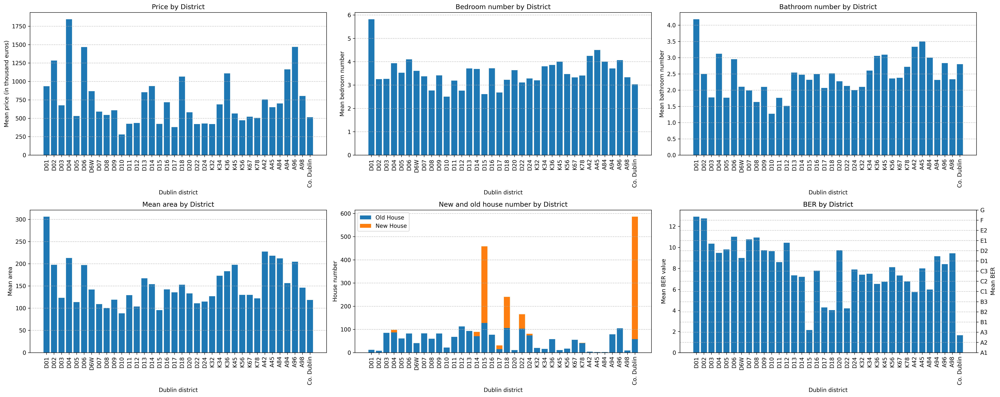

In [6]:
plt.figure(figsize=(25, 10), dpi=300)

# plot 1:
plt.subplot(2, 3, 1)
plt.bar(district_groups.index, district_groups['mean_price'])
plt.xticks(rotation=90)
plt.xlabel('Dublin district')
plt.ylabel('Mean price (in thousand euros)')
plt.title('Price by District')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# plot 2:
plt.subplot(2, 3, 2)
plt.bar(district_groups.index, district_groups['mean_bedroom_number'])
plt.xticks(rotation=90)
plt.xlabel('Dublin district')
plt.ylabel('Mean bedroom number')
plt.title('Bedroom number by District')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# plot 3:
plt.subplot(2, 3, 3)
plt.bar(district_groups.index, district_groups['mean_bathroom_number'])
plt.xticks(rotation=90)
plt.xlabel('Dublin district')
plt.ylabel('Mean bathroom number')
plt.title('Bathroom number by District')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# plot 4:
plt.subplot(2, 3, 4)
plt.bar(district_groups.index, district_groups['mean_area'])
plt.xticks(rotation=90)
plt.xlabel('Dublin district')
plt.ylabel('Mean area')
plt.title('Mean area by District')
plt.grid(axis='y', linestyle='--', alpha=0.7)

# plot 5:
plt.subplot(2, 3, 5)
plt.bar(district_groups.index, district_groups['old_house_number'], label='Old House')
plt.bar(district_groups.index, district_groups['new_house_number'], bottom=district_groups['old_house_number'], label='New House')
plt.xticks(rotation=90)
plt.xlabel('Dublin district')
plt.ylabel('House number')
plt.title('New and old house number by District')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.legend()

# plot 6:
ax1 = plt.subplot(2, 3, 6)
plt.bar(district_groups.index, district_groups['mean_ber'])
plt.xticks(rotation=90)
ax1.set_xlabel('Dublin district')
ax1.set_ylabel('Mean BER value')
ax1.set_title('BER by District')

ax2 = ax1.twinx()
# Define custom y-tick labels
yticks_labels = ['A1', 'A2', 'A3', 'B1', 'B2', 'B3', 'C1', 'C2', 'C3', 'D1', 'D2', 'E1', 'E2', 'F', 'G']
yticks = np.linspace(ax1.get_ylim()[0], ax1.get_ylim()[1], len(yticks_labels))

# Set the ticks and labels on the secondary y-axis
ax2.set_yticks(yticks)
ax2.set_yticklabels(yticks_labels)

# Hide the right y-axis ticks
ax2.tick_params(axis='y', which='both', left=False)

# Add grid lines for better readability (optional)
ax2.grid(axis='y', linestyle='--', alpha=0.3)

ax2.set_ylabel('Mean BER')
plt.title('BER by District')
plt.grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout()
plt.savefig('EDA/3.basic_statistics_3.jpg')
plt.show()

### New & Old House Gelocation

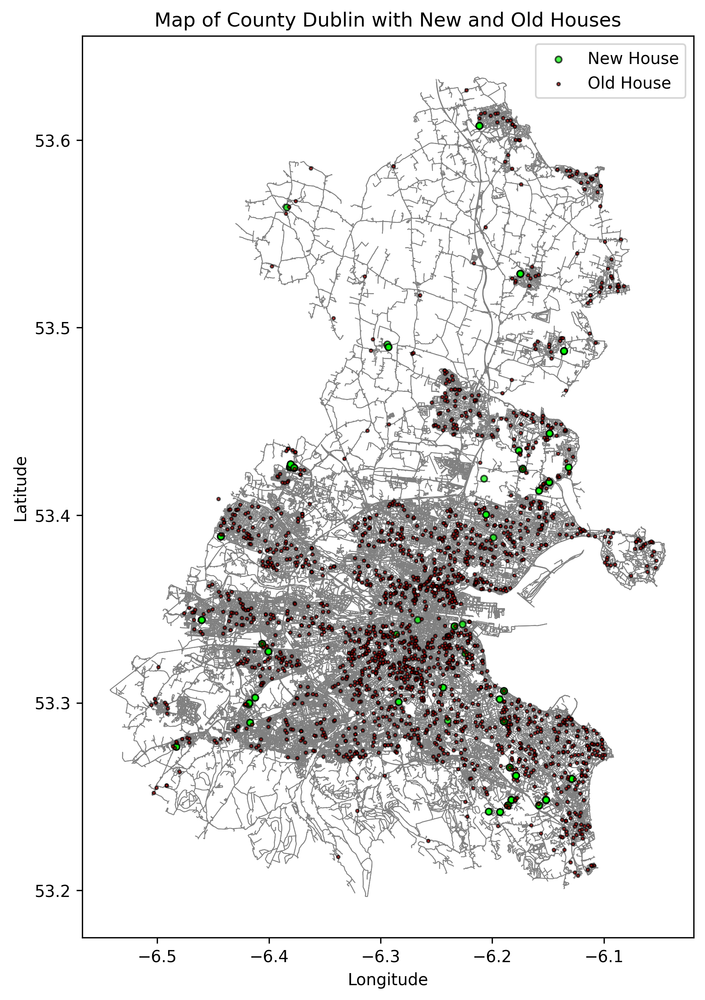

In [7]:
import osmnx as ox
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

# Sample DataFrame with latitude, longitude, and house type
map_data = source[['lat', 'lng', 'new_house']].copy()  # Ensure to use .copy() to avoid SettingWithCopyWarning
map_data.rename(columns={"new_house": "house_type"}, inplace=True)

# Convert DataFrame to GeoDataFrame
gdf_locations = gpd.GeoDataFrame(
    map_data,
    geometry=gpd.points_from_xy(map_data.lng, map_data.lat),
    crs="EPSG:4326"  # WGS84 coordinate system
)

# Fetch the base map for the area
place_name = "County Dublin"
graph = ox.graph_from_place(place_name, network_type='all')
gdf_edges = ox.graph_to_gdfs(graph, nodes=False, edges=True)

# Separate the locations into new and old houses
gdf_new_houses = gdf_locations[gdf_locations['house_type'] == 'YES']
gdf_old_houses = gdf_locations[gdf_locations['house_type'] == 'NO']

# Plot the map
fig, ax = plt.subplots(figsize=(10, 10), dpi=300)

# Plot the base map
gdf_edges.plot(ax=ax, linewidth=0.5, color='gray')

# Plot new houses
gdf_new_houses.plot(ax=ax, color='lime', markersize=15, alpha=0.7, edgecolor='k', label='New House', zorder=2)

# Plot old houses
gdf_old_houses.plot(ax=ax, color='red', markersize=3, alpha=0.7, edgecolor='k', label='Old House', zorder=2)

# Customize plot
ax.set_title(f'Map of {place_name} with New and Old Houses')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.legend()
plt.savefig('EDA/4.basic_statistics_house_locations.jpg')
# Show plot
plt.show()

### Railway, School, Supermarket and GP Statistics

In [8]:
# filter supermarket based on the box border
offset = 0.05
top_border = source['lat'].max() + offset
bottom_border = source['lat'].min() - offset
left_border = source['lng'].min() - offset
right_border = source['lng'].max() + offset

# supermarket
aldi_supermarket = pd.read_csv('../raw_data/aldi_supermarket.csv')
lidl_supermarket = pd.read_csv('../raw_data/lidl_supermarket.csv')
tesco_supermarket = pd.read_csv('../raw_data/tesco_supermarket.csv')
dunnes_supermarket = pd.read_csv('../raw_data/dunnes_stores_supermarket.csv')
supervalu_supermarket = pd.read_csv('../raw_data/supervalu_supermarket.csv')
# fileter box border with offset
dublin_aldi_supermarket = aldi_supermarket[
    (aldi_supermarket['lat'].between(bottom_border, top_border)) & 
    (aldi_supermarket['lng'].between(left_border, right_border))]
dublin_lidl_supermarket = lidl_supermarket[
    (lidl_supermarket['lat'].between(bottom_border, top_border)) & 
    (lidl_supermarket['lng'].between(left_border, right_border))]
dublin_tesco_supermarket = tesco_supermarket[
    (tesco_supermarket['lat'].between(bottom_border, top_border)) & 
    (tesco_supermarket['lng'].between(left_border, right_border))]
dublin_dunnes_supermarket = dunnes_supermarket[
    (dunnes_supermarket['lat'].between(bottom_border, top_border)) & 
    (dunnes_supermarket['lng'].between(left_border, right_border))]
dublin_supervalu_supermarket = supervalu_supermarket[
    (supervalu_supermarket['lat'].between(bottom_border, top_border)) & 
    (supervalu_supermarket['lng'].between(left_border, right_border))]

print(f'Supermarket:')
print(f'Irish Aldi total number: {len(aldi_supermarket)}, county Dublin Aldi number: {len(dublin_aldi_supermarket)}')
print(f'Irish Lidl total number: {len(lidl_supermarket)}, county Dublin Lidl number: {len(dublin_lidl_supermarket)}')
print(f'Irish Tesco total number: {len(tesco_supermarket)}, county Dublin Tesco number: {len(dublin_tesco_supermarket)}')
print(f'Irish Dunnes total number: {len(dunnes_supermarket)}, county Dublin Dunnes number: {len(dublin_dunnes_supermarket)}')
print(f'Irish Supervalu total number: {len(supervalu_supermarket)}, county Dublin Supervalu number: {len(dublin_supervalu_supermarket)}\n')

# railway
rail = pd.read_csv('../raw_data/rail_result.csv')
dublin_rail = rail[
    (rail['lat'].between(bottom_border, top_border)) & 
    (rail['lng'].between(left_border, right_border))]
print(f'Dart, train &luas:')
print(f'County Dublin railway stops number: {len(rail)}, county Dublin rail number: {len(dublin_rail)}\n')

# school
schools = pd.read_csv('../raw_data/school_result.csv')
# Function to extract latitude and longitude
def extract_lat_lng(url):
    # Split the URL to get the part with coordinates
    coord_str = url.split('q=')[1]
    # Split the coordinates by comma
    lat, lng = coord_str.split(',')
    return float(lat), float(lng)
# Apply the function and create new columns
schools[['lat', 'lng']] = schools['google_map'].apply(lambda x: pd.Series(extract_lat_lng(x)))

dublin_schools = schools[
    (schools['lat'].between(bottom_border, top_border)) & 
    (schools['lng'].between(left_border, right_border))]
print(f'Schools')
print(f'Irish school total number: {len(schools)}, county Dublin school number: {len(dublin_schools)}\n')

# GP
gp = pd.read_csv('../raw_data/gp_result_with_loc.csv')
dublin_gp = gp[
    (gp['lat'].between(bottom_border, top_border)) & 
    (gp['lng'].between(left_border, right_border))]
print(f'GP (family doctor)')
print(f'Irish GP total number: {len(gp)}, county Dublin GP number: {len(dublin_gp)}\n')

Supermarket:
Irish Aldi total number: 159, county Dublin Aldi number: 33
Irish Lidl total number: 179, county Dublin Lidl number: 58
Irish Tesco total number: 180, county Dublin Tesco number: 79
Irish Dunnes total number: 137, county Dublin Dunnes number: 41
Irish Supervalu total number: 221, county Dublin Supervalu number: 52

Dart, train &luas:
County Dublin railway stops number: 151, county Dublin rail number: 133

Schools
Irish school total number: 3971, county Dublin school number: 784

GP (family doctor)
Irish GP total number: 1417, county Dublin GP number: 425



In [9]:
# house data
map_data_full = source[['lat', 'lng', 'new_house']].copy()
map_data_full.replace('NO', 'old_house', inplace=True)
map_data_full.replace('YES', 'new_house', inplace=True)
map_data_full.rename(columns={'new_house': 'data_type'}, inplace=True)

# supermarket data
map_data_aldi = dublin_aldi_supermarket[['lat', 'lng', 'store']].copy()
map_data_aldi.rename(columns={'store': 'data_type'}, inplace=True)
map_data_lidl = dublin_lidl_supermarket[['lat', 'lng', 'store']].copy()
map_data_lidl.rename(columns={'store': 'data_type'}, inplace=True)
map_data_tesco = dublin_tesco_supermarket[['lat', 'lng', 'store']].copy()
map_data_tesco.rename(columns={'store': 'data_type'}, inplace=True)
map_data_dunnes = dublin_dunnes_supermarket[['lat', 'lng', 'store']].copy()
map_data_dunnes.rename(columns={'store': 'data_type'}, inplace=True)
map_data_supervalu = dublin_supervalu_supermarket[['lat', 'lng', 'store']].copy()
map_data_supervalu.rename(columns={'store': 'data_type'}, inplace=True)
map_data_supermarket = pd.concat([map_data_aldi, map_data_lidl, map_data_tesco, map_data_dunnes, map_data_supervalu])

# rail
map_data_rail = dublin_rail[['lat', 'lng']].copy()
map_data_rail['data_type'] = 'rail'

# schools
map_data_schools = dublin_schools[['lat', 'lng']].copy()
map_data_schools['data_type'] = 'schools'

# GP
map_data_gp = dublin_gp[['lat', 'lng']].copy()
map_data_gp['data_type'] = 'gp'
map_data = pd.concat([map_data_full, map_data_supermarket, map_data_rail, map_data_schools, map_data_gp])
# map_data

### House Geolocation with Rail

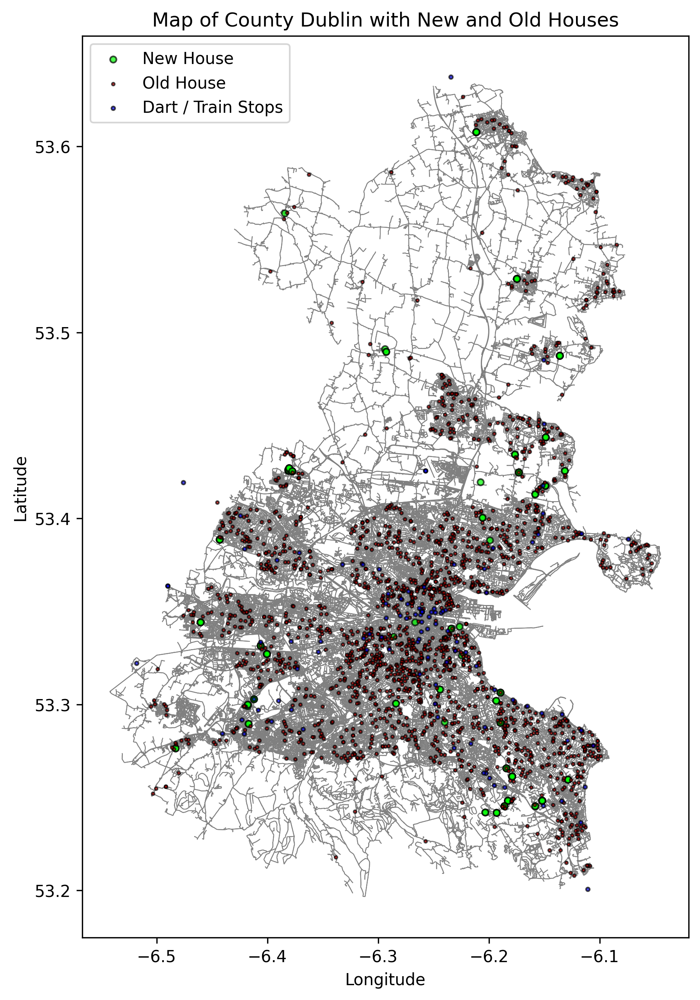

In [10]:
import osmnx as ox
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

# Convert DataFrame to GeoDataFrame
gdf_locations = gpd.GeoDataFrame(
    map_data,
    geometry=gpd.points_from_xy(map_data.lng, map_data.lat),
    crs="EPSG:4326"  # WGS84 coordinate system
)

# Fetch the base map for the area
place_name = "County Dublin"
graph = ox.graph_from_place(place_name, network_type='all')
gdf_edges = ox.graph_to_gdfs(graph, nodes=False, edges=True)

# Separate the locations into new and old houses
gdf_new_houses = gdf_locations[gdf_locations['data_type'] == 'new_house']
gdf_old_houses = gdf_locations[gdf_locations['data_type'] == 'old_house']
gdf_aldi = gdf_locations[gdf_locations['data_type'] == 'aldi']
gdf_lidl = gdf_locations[gdf_locations['data_type'] == 'lidl']
gdf_tesco = gdf_locations[gdf_locations['data_type'] == 'tesco']
gdf_dunnes_stores = gdf_locations[gdf_locations['data_type'] == 'dunnes_stores']
gdf_supervalu = gdf_locations[gdf_locations['data_type'] == 'supervalu']
gdf_schools = gdf_locations[gdf_locations['data_type'] == 'schools']
gdf_rail = gdf_locations[gdf_locations['data_type'] == 'rail']
gdf_gp = gdf_locations[gdf_locations['data_type'] == 'gp']

# Plot the map
fig, ax = plt.subplots(figsize=(10, 10), dpi=300)

# Plot the base map
gdf_edges.plot(ax=ax, linewidth=0.5, color='gray')

# Plot new houses
gdf_new_houses.plot(ax=ax, color='lime', markersize=15, alpha=0.7, edgecolor='k', label='New House', zorder=2)

# Plot old houses
gdf_old_houses.plot(ax=ax, color='red', markersize=3, alpha=0.7, edgecolor='k', label='Old House', zorder=2)

# Plot rail stops
gdf_rail.plot(ax=ax, color='blue', markersize=5, alpha=0.7, edgecolor='k', label='Dart / Train Stops', zorder=2)

# # Plot schools
# gdf_schools.plot(ax=ax, color='yellow', markersize=3, alpha=0.7, edgecolor='k', label='Schools', zorder=2)

# Customize plot
ax.set_title(f'Map of {place_name} with New and Old Houses')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.legend()
plt.savefig('EDA/5.basic_statistics_house_locations_with_rail.jpg')

# Show plot
plt.show()

#### Business Perspective

<p>There is no suprice that new house will be near railway stops (dart, train and luas), and probably that is the house selling points.</p>

### House Geolocation with Surrounding Facilities

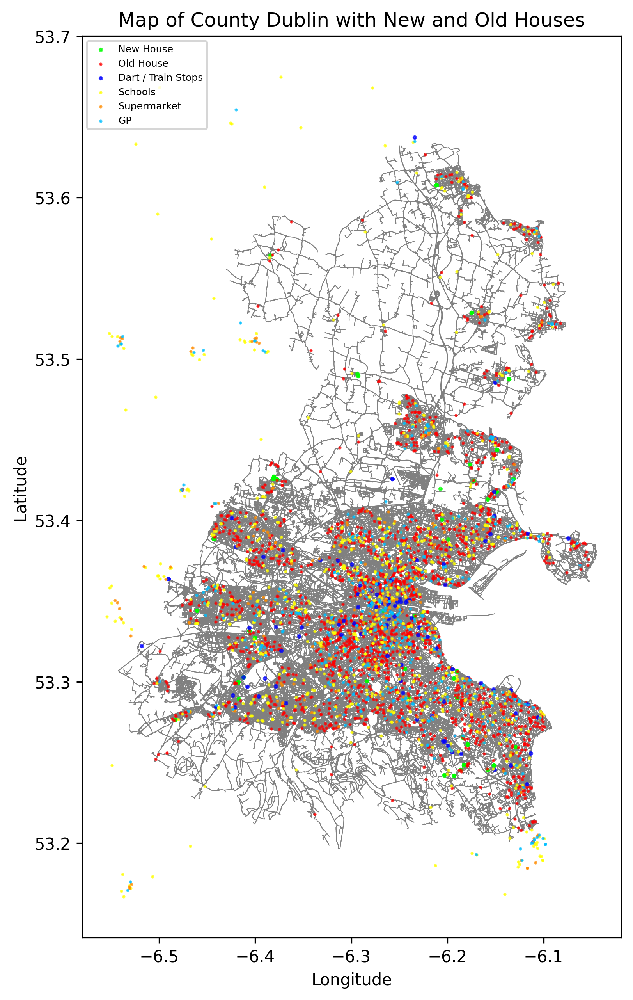

In [11]:
# Plot the map
fig, ax = plt.subplots(figsize=(10, 10), dpi=300)

# Plot the base map
gdf_edges.plot(ax=ax, linewidth=0.5, color='gray')

# Plot new houses
gdf_new_houses.plot(ax=ax, color='lime', markersize=3, alpha=0.7, label='New House', zorder=2)

# Plot old houses
gdf_old_houses.plot(ax=ax, color='red', markersize=1, alpha=0.7, label='Old House', zorder=2)

# Plot rail stops
gdf_rail.plot(ax=ax, color='blue', markersize=3, alpha=0.7, label='Dart / Train Stops', zorder=2)

# Plot schools
gdf_schools.plot(ax=ax, color='yellow', markersize=1, alpha=0.7, label='Schools', zorder=2)

# Plot supermarket
gdf_supermarket = pd.concat([gdf_aldi, gdf_lidl, gdf_dunnes_stores, gdf_tesco, gdf_supervalu])
gdf_supermarket.plot(ax=ax, color='darkorange', markersize=1, alpha=0.7, label='Supermarket', zorder=2)

# Plot GP
gdf_gp.plot(ax=ax, color='deepskyblue', markersize=1, alpha=0.7, label='GP', zorder=2)

# Customize plot
ax.set_title(f'Map of {place_name} with New and Old Houses')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.legend(loc='upper left', prop={'size': 6})
plt.savefig('EDA/6.basic_statistics_house_surroundings.jpg')

# Show plot
plt.show()

### Facilities Mean Distance & Unit Number to Each House

In [12]:
import numpy as np
from geopy.distance import geodesic
import pandas as pd

def calculate_distance_stats(house_location, facility_locations, distance_thresholds):
    """
    Calculate distance statistics to the nearest facilities.
    
    Parameters:
    - house_location: Tuple of (latitude, longitude) for the house
    - facility_locations: List of tuples (latitude, longitude) for facilities
    - distance_thresholds: List of distance thresholds for classification
    
    Returns:
    - Dictionary of means and counts for each distance threshold
    """
    facility_distances = [geodesic(house_location, facility_location).meters for facility_location in facility_locations]
    results = {}
    for threshold in distance_thresholds:
        filtered_distances = [distance for distance in facility_distances if distance < threshold]
        results[f'{threshold}_mean'] = np.mean(filtered_distances) if filtered_distances else 0
        results[f'{threshold}_unit'] = len(filtered_distances)
    return results

def calculate_school_distance_stats(house_location, facility_groups, distance_thresholds):
    """
    Calculate distance statistics to the nearest facilities for each type.
    
    Parameters:
    - house_location: Tuple of (latitude, longitude) for the house
    - facility_groups: Dictionary where keys are facility types and values are lists of (latitude, longitude) tuples for facilities
    - distance_thresholds: List of distance thresholds for classification
    
    Returns:
    - Dictionary of means and counts for each distance threshold, categorized by facility type
    """
    results = {}
    for facility_type, facility_locations in facility_groups.items():
        facility_distances = [geodesic(house_location, facility_location).meters for facility_location in facility_locations]
        for threshold in distance_thresholds:
            filtered_distances = [distance for distance in facility_distances if distance < threshold]
            results_key_prefix = f'{facility_type}_{threshold}'
            results[f'{results_key_prefix}_mean'] = np.mean(filtered_distances) if filtered_distances else 0
            results[f'{results_key_prefix}_unit'] = len(filtered_distances)
    return results

# Define distance thresholds
distance_thresholds = [1000, 3000, 5000]

# Helper function to extract locations from DataFrames
def extract_location_list(df):
    return [tuple(record) for record in df[['lat', 'lng']].dropna().to_records(index=False)]

# Extract locations
dublin_rail_location_list = extract_location_list(dublin_rail)
dublin_aldi_location_list = extract_location_list(dublin_aldi_supermarket)
dublin_lidl_location_list = extract_location_list(dublin_lidl_supermarket)
dublin_tesco_location_list = extract_location_list(dublin_tesco_supermarket)
dublin_dunnes_location_list = extract_location_list(dublin_dunnes_supermarket)
dublin_supervalu_location_list = extract_location_list(dublin_supervalu_supermarket)
dublin_gp_location_list = extract_location_list(dublin_gp)

# Process school locations and group by type
dublin_school_locations = dublin_schools[['lat', 'lng', 'school_Level']].dropna()
dublin_school_locations['school_Level'] = dublin_school_locations['school_Level'].str.replace(' ', '_').str.lower()
facility_groups = dublin_school_locations.groupby('school_Level').apply(lambda g: extract_location_list(g), include_groups=False).to_dict()

print(f'Assemble data')
# Process each row in the source DataFrame
for index, row in source.iterrows():
    if (index % 100 == 0 and index < len(source)) or index == len(source) - 1:
        print(f'[{index+1}/{len(source)}] record is processing')
    
    house_location = (row['lat'], row['lng'])
    
    # Calculate distance statistics for different facilities
    facilities = {
        'rail': dublin_rail_location_list,
        'aldi': dublin_aldi_location_list,
        'lidl': dublin_lidl_location_list,
        'tesco': dublin_tesco_location_list,
        'dunnes': dublin_dunnes_location_list,
        'supervalu': dublin_supervalu_location_list,
        'gp': dublin_gp_location_list
    }
    
    for facility_name, locations in facilities.items():
        distance_stats = calculate_distance_stats(house_location, locations, distance_thresholds)
        for threshold in distance_thresholds:
            source.at[index, f'{facility_name}_{threshold}_distance_mean'] = distance_stats[f'{threshold}_mean']
            source.at[index, f'{facility_name}_{threshold}_distance_unit'] = distance_stats[f'{threshold}_unit']
    
    # Calculate distance statistics to schools
    school_distance_stats = calculate_school_distance_stats(house_location, facility_groups, distance_thresholds)
    for facility_type in facility_groups.keys():
        for threshold in distance_thresholds:
            source.at[index, f'school_{facility_type}_{threshold}_distance_mean'] = school_distance_stats[f'{facility_type}_{threshold}_mean']
            source.at[index, f'school_{facility_type}_{threshold}_distance_unit'] = school_distance_stats[f'{facility_type}_{threshold}_unit']
    
    # # Print results (Optional, can be commented out to improve performance)
    # for facility_name in facilities.keys():
    #     for threshold in distance_thresholds:
    #         print(f'{facility_name}_{threshold}_distance_mean: {source.at[index, f"{facility_name}_{threshold}_distance_mean"]}, {facility_name}_{threshold}_distance_unit: {source.at[index, f"{facility_name}_{threshold}_distance_unit"]}')
    # for facility_type in facility_groups.keys():
    #     for threshold in distance_thresholds:
    #         print(f'school_{facility_type}_{threshold}_distance_mean: {source.at[index, f"school_{facility_type}_{threshold}_distance_mean"]}, school_{facility_type}_{threshold}_distance_unit: {source.at[index, f"school_{facility_type}_{threshold}_distance_unit"]}')

Assemble data
[1/2088] record is processing
[101/2088] record is processing
[301/2088] record is processing
[401/2088] record is processing
[501/2088] record is processing
[601/2088] record is processing
[701/2088] record is processing
[801/2088] record is processing
[901/2088] record is processing
[1001/2088] record is processing
[1101/2088] record is processing
[1201/2088] record is processing
[1301/2088] record is processing
[1401/2088] record is processing
[1501/2088] record is processing
[1601/2088] record is processing
[1701/2088] record is processing
[1801/2088] record is processing
[1901/2088] record is processing
[2001/2088] record is processing
[2088/2088] record is processing


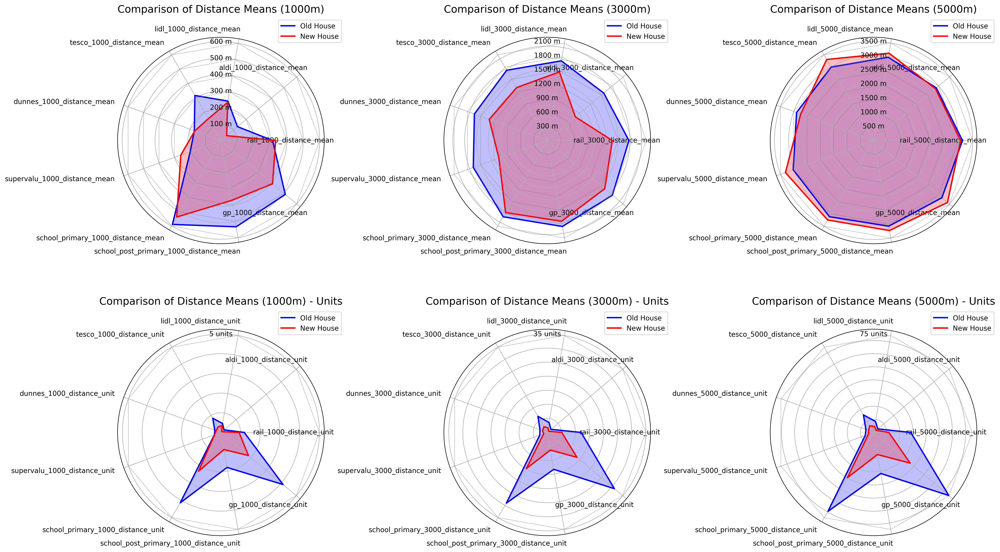

In [13]:
distance_agg = source.groupby('new_house').agg(
    # rail
    rail_1000_distance_mean = ('rail_1000_distance_mean', 'mean'),
    rail_1000_distance_unit = ('rail_1000_distance_unit', 'mean'),
    rail_3000_distance_mean = ('rail_3000_distance_mean', 'mean'),
    rail_3000_distance_unit = ('rail_3000_distance_unit', 'mean'),
    rail_5000_distance_mean = ('rail_5000_distance_mean', 'mean'),
    rail_5000_distance_unit = ('rail_5000_distance_unit', 'mean'),

    # supermarket
    aldi_1000_distance_mean = ('aldi_1000_distance_mean', 'mean'),
    aldi_1000_distance_unit = ('aldi_1000_distance_unit', 'mean'),
    lidl_1000_distance_mean = ('lidl_1000_distance_mean', 'mean'),
    lidl_1000_distance_unit = ('lidl_1000_distance_unit', 'mean'),
    tesco_1000_distance_mean = ('tesco_1000_distance_mean', 'mean'),
    tesco_1000_distance_unit = ('tesco_1000_distance_unit', 'mean'),
    dunnes_1000_distance_mean = ('dunnes_1000_distance_mean', 'mean'),
    dunnes_1000_distance_unit = ('dunnes_1000_distance_unit', 'mean'),
    supervalu_1000_distance_mean = ('supervalu_1000_distance_mean', 'mean'),
    supervalu_1000_distance_unit = ('supervalu_1000_distance_unit', 'mean'),
    aldi_3000_distance_mean = ('aldi_3000_distance_mean', 'mean'),
    aldi_3000_distance_unit = ('aldi_3000_distance_unit', 'mean'),
    lidl_3000_distance_mean = ('lidl_3000_distance_mean', 'mean'),
    lidl_3000_distance_unit = ('lidl_3000_distance_unit', 'mean'),
    tesco_3000_distance_mean = ('tesco_3000_distance_mean', 'mean'),
    tesco_3000_distance_unit = ('tesco_3000_distance_unit', 'mean'),
    dunnes_3000_distance_mean = ('dunnes_3000_distance_mean', 'mean'),
    dunnes_3000_distance_unit = ('dunnes_3000_distance_unit', 'mean'),
    supervalu_3000_distance_mean = ('supervalu_3000_distance_mean', 'mean'),
    supervalu_3000_distance_unit = ('supervalu_3000_distance_unit', 'mean'),
    aldi_5000_distance_mean = ('aldi_5000_distance_mean', 'mean'),
    aldi_5000_distance_unit = ('aldi_5000_distance_unit', 'mean'),
    lidl_5000_distance_mean = ('lidl_5000_distance_mean', 'mean'),
    lidl_5000_distance_unit = ('lidl_5000_distance_unit', 'mean'),
    tesco_5000_distance_mean = ('tesco_5000_distance_mean', 'mean'),
    tesco_5000_distance_unit = ('tesco_5000_distance_unit', 'mean'),
    dunnes_5000_distance_mean = ('dunnes_5000_distance_mean', 'mean'),
    dunnes_5000_distance_unit = ('dunnes_5000_distance_unit', 'mean'),
    supervalu_5000_distance_mean = ('supervalu_5000_distance_mean', 'mean'),
    supervalu_5000_distance_unit = ('supervalu_5000_distance_unit', 'mean'),

    # schools
    school_primary_1000_distance_mean = ('school_primary_1000_distance_mean', 'mean'),
    school_primary_1000_distance_unit = ('school_primary_1000_distance_unit', 'mean'),
    school_primary_3000_distance_mean = ('school_primary_3000_distance_mean', 'mean'),
    school_primary_3000_distance_unit = ('school_primary_3000_distance_unit', 'mean'),
    school_primary_5000_distance_mean = ('school_primary_5000_distance_mean', 'mean'),
    school_primary_5000_distance_unit = ('school_primary_5000_distance_unit', 'mean'),
    school_post_primary_1000_distance_mean = ('school_post_primary_1000_distance_mean', 'mean'),
    school_post_primary_1000_distance_unit = ('school_post_primary_1000_distance_unit', 'mean'),
    school_post_primary_3000_distance_mean = ('school_post_primary_3000_distance_mean', 'mean'),
    school_post_primary_3000_distance_unit = ('school_post_primary_3000_distance_unit', 'mean'),
    school_post_primary_5000_distance_mean = ('school_post_primary_5000_distance_mean', 'mean'),
    school_post_primary_5000_distance_unit = ('school_post_primary_5000_distance_unit', 'mean'),

    # GP
    gp_1000_distance_mean = ('gp_1000_distance_mean', 'mean'),
    gp_1000_distance_unit = ('gp_1000_distance_unit', 'mean'),
    gp_3000_distance_mean = ('gp_3000_distance_mean', 'mean'),
    gp_3000_distance_unit = ('gp_3000_distance_unit', 'mean'),
    gp_5000_distance_mean = ('gp_5000_distance_mean', 'mean'),
    gp_5000_distance_unit = ('gp_5000_distance_unit', 'mean'),
).T

distance_agg.columns = ['old_house', 'new_house']
# distance_agg

# Function to create radar plots
def plot_radar(ax, df, title, interval, unit_label):
    # Number of variables
    categories = list(df.index)
    N = len(categories)
    
    # Compute angle for each axis
    angles = np.linspace(0, 2 * np.pi, N, endpoint=False).tolist()
    angles += angles[:1]  # Complete the loop
    categories += categories[:1]  # Complete the loop

    def radar_plot(values, color, label):
        values += values[:1]  # Complete the loop
        ax.plot(angles, values, color=color, linewidth=2, label=label)
        ax.fill(angles, values, color=color, alpha=0.25)

    # Plot 'old_house'
    radar_plot(df['old_house'].tolist(), 'blue', 'Old House')

    # Plot 'new_house'
    radar_plot(df['new_house'].tolist(), 'red', 'New House')

    # Add labels and grid lines
    ax.set_yticklabels([])
    ax.set_xticks(angles[:-1])  # Set ticks to match the number of categories
    ax.set_xticklabels(categories[:-1], rotation=45, ha='right')
    
    max_value = df.max().max()  # Find maximum value in the data to determine grid extent
    num_levels = int(np.ceil(max_value / interval))  # Calculate number of grid lines needed

    for i in range(1, num_levels + 1):
        radius = i * interval
        ax.plot(angles, [radius] * (N + 1), color='gray', linestyle='--', linewidth=0.5)  # Draw circular grid lines
        ax.text(np.pi / 2, radius, f'{radius} {unit_label}', horizontalalignment='center', verticalalignment='center', color='black')

    # Add a title
    ax.set_title(title, size=15, color='black', y=1.1)

    # Add a legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))

# Initialize the figure and subplots
fig, axs = plt.subplots(2, 3, figsize=(20, 12), dpi=300, subplot_kw=dict(polar=True))

# Plot for 1000 meters
mean_1000_index = [index_name for index_name in distance_agg.index if '1000' in index_name and 'mean' in index_name]
df_1000 = distance_agg.loc[mean_1000_index]
plot_radar(axs[0, 0], df_1000, 'Comparison of Distance Means (1000m)', interval=100, unit_label='m')

# Plot for 3000 meters
mean_3000_index = [index_name for index_name in distance_agg.index if '3000' in index_name and 'mean' in index_name]
df_3000 = distance_agg.loc[mean_3000_index]
plot_radar(axs[0, 1], df_3000, 'Comparison of Distance Means (3000m)', interval=300, unit_label='m')

# Plot for 5000 meters
mean_5000_index = [index_name for index_name in distance_agg.index if '5000' in index_name and 'mean' in index_name]
df_5000 = distance_agg.loc[mean_5000_index]
plot_radar(axs[0, 2], df_5000, 'Comparison of Distance Means (5000m)', interval=500, unit_label='m')

# Plot for 1000 meters (unit)
mean_1000_index = [index_name for index_name in distance_agg.index if '1000' in index_name and 'unit' in index_name]
df_1000 = distance_agg.loc[mean_1000_index]
plot_radar(axs[1, 0], df_1000, 'Comparison of Distance Means (1000m) - Units', interval=5, unit_label='units')

# Plot for 3000 meters (unit)
mean_3000_index = [index_name for index_name in distance_agg.index if '3000' in index_name and 'unit' in index_name]
df_3000 = distance_agg.loc[mean_3000_index]
plot_radar(axs[1, 1], df_3000, 'Comparison of Distance Means (3000m) - Units', interval=35, unit_label='units')

# Plot for 5000 meters (unit)
mean_5000_index = [index_name for index_name in distance_agg.index if '5000' in index_name and 'unit' in index_name]
df_5000 = distance_agg.loc[mean_5000_index]
plot_radar(axs[1, 2], df_5000, 'Comparison of Distance Means (5000m) - Units', interval=75, unit_label='units')

# Adjust layout
plt.tight_layout()
plt.savefig('EDA/7.basic_statistics_house_surroundings_comparison.jpg')

# Show the plot
plt.show()

#### save the district mean table to image

In [14]:
# Plot the DataFrame as a table
fig, ax = plt.subplots(figsize=(8, 4), dpi=600)  # Set the size of the figure
ax.axis('off')  # Hide the axis

# Add the index to the DataFrame
df_rounded = district_groups.round(2)
df_rounded['mean_ber'] = formate_BER_inverse(df_rounded['mean_ber'].apply(lambda x: int(round(x, 0))))
df_rounded = df_rounded.reset_index()

# Create the table
tbl = ax.table(cellText=df_rounded.values, colLabels=df_rounded.columns, cellLoc='center', loc='center')

# Customize the header
header_color = 'lightskyblue'
header_font_size = 2.8
cell_font_size = 4

# Set header color and font size
for (i, key) in enumerate(tbl.get_celld().keys()):
    cell = tbl.get_celld()[key]
    if key[0] == 0:  # Header row
        cell.set_text_props(weight='bold', fontsize=header_font_size)
        cell.set_facecolor(header_color)
    else:
        cell.set_text_props(fontsize=cell_font_size)

# Adjust the size of the table to fit the content better
tbl.auto_set_font_size(False)  # Disable auto font size to use specified sizes
# tbl.scale(1.2, 1.2)  # Scale the table to better fit larger text

# Save the plot as a PNG file
plt.savefig('EDA/8.districts_statistics.jpg', bbox_inches='tight', dpi=600)
plt.close(fig)

## Data Preprocessing

In [15]:
price_mean = np.mean(source['price'])
price_std = np.std(source['price'])

# trim data

# STD
source_untrimmed = source.copy()
source = source[source['price'] < price_mean + 3 * price_std]

# # IQR
# price_no_na = source['price'].dropna()
# Q1 = price_no_na.quantile(0.25)
# Q3 = price_no_na.quantile(0.75)
# IQR = Q3 - Q1
# source = source[source['price'] < (Q3 + 1.5 * IQR)]


feature_source = source.drop(columns=['url', 'address', 'ber_epi', 'description', 'features', 'district'])
feature_source.dropna(subset=['price'], inplace=True)
print(f'original source shape: {source.shape}\nfeature source (dropna on price) shape: {feature_source.shape}')

# separate features and labels
label = feature_source['price']
features = feature_source.drop(columns=['price']).reset_index(drop=True)
print(f'feature shape: {features.shape}\nlabel shape: {label.shape}')


# log normalize the price
# we have already known the price is exponential distributed, right-skewed. Many regression models assume that
# the target variable  y  is normally distributed. If  y  is right-skewed, it can violate this assumption 
# and impact model performance. Let's log normalize the target variable.
# Note: inverse operation: np.expm1(x) / exp(x) - 1
label = np.log1p(label)

# Separate categorical feature and numerical features
categorical_columns = ['house_type', 'new_house']
numerical_columns = [column for column in features.columns if column not in categorical_columns]

features.info()

original source shape: (1993, 78)
feature source (dropna on price) shape: (1993, 72)
feature shape: (1993, 71)
label shape: (1993,)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1993 entries, 0 to 1992
Data columns (total 71 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   bed_number                                   1977 non-null   float64
 1   bath_number                                  1945 non-null   float64
 2   area                                         1755 non-null   float64
 3   house_type                                   1993 non-null   object 
 4   new_house                                    1993 non-null   object 
 5   ber                                          1993 non-null   int64  
 6   property_views                               1993 non-null   int64  
 7   lat                                          1993 non-null   float64
 8   lng             

#### Dependency / Correlation Analysis

In [16]:
# Function to create a heatmap
def plot_heatmap(ax, correlation_matrix, title):
    # Create a colormap
    cmap = plt.get_cmap('coolwarm')

    # Create the heatmap
    cax = ax.imshow(correlation_matrix, cmap=cmap, vmin=-1, vmax=1)

    # Add color bar
    cbar = fig.colorbar(cax, ax=ax, orientation='vertical', fraction=0.04, pad=0.15)
    cbar.set_label('Correlation coefficient')

    # Set ticks and labels
    ax.set_xticks(np.arange(len(correlation_matrix.columns)))
    ax.set_yticks(np.arange(len(correlation_matrix.columns)))
    ax.set_xticklabels(correlation_matrix.columns, rotation=45, ha='right')
    ax.set_yticklabels(correlation_matrix.columns)

    # Add annotations
    for i in range(len(correlation_matrix.columns)):
        for j in range(len(correlation_matrix.columns)):
            text = ax.text(j, i, f'{correlation_matrix.iloc[i, j]:.2f}', ha='center', va='center', color='black')

    # Set title and labels
    ax.set_title(title, size=16)
    ax.set_xlabel('Features')
    ax.set_ylabel('Features')

# Prepare the figure and axes
fig, axs = plt.subplots(1, 3, figsize=(60, 20), dpi=300)

# First heatmap
general_features_columns = [column for column in numerical_columns if all(substring not in column for substring in ['1000', '3000', '5000'])]
correlation_matrix = features[general_features_columns].dropna().corr()
plot_heatmap(axs[0], correlation_matrix, 'Correlation Heatmap (General Features)')

# Second heatmap
filtered_features_mean = [
    item for item in features.columns
    if (item.endswith('1000_distance_mean') or
        item.endswith('3000_distance_mean') or
        item.endswith('5000_distance_mean'))
]
correlation_matrix = features[filtered_features_mean].dropna().corr()
plot_heatmap(axs[1], correlation_matrix, 'Correlation Heatmap (Distance Means)')

# Third heatmap
filtered_features_unit = [
    item for item in features.columns
    if (item.endswith('1000_distance_unit') or
        item.endswith('3000_distance_unit') or
        item.endswith('5000_distance_unit'))
]
correlation_matrix = features[filtered_features_unit].dropna().corr()
plot_heatmap(axs[2], correlation_matrix, 'Correlation Heatmap (Distance Units)')

# Adjust layout
plt.tight_layout()
plt.savefig('FeatureEngineering/1.feature_correlation_heatmap.jpg')

# Show the plot
plt.show()

<h4>Pearson Correlation coefficient (PCC) heatmap says a lot:</h4>
<ul>
    <li>General features have some correlation among each other, but not significant (r<sup>2</sup> < 0.85).</li>
    <li>Distance means also show low correlation.</li>
    <li>Distance units shows significant correlation, especially among 3000 & 5000 meters / units. Considering this is an aggregation feature (average dunnes store number within 3000m), from a practical and business perspective, actuall not 0 is enough, in this case, <strong>all features in this heatmap should be discard</strong>.</li>
</ul>

In [17]:
filtered_features_unit = [
    item for item in features.columns
    if (item.endswith('1000_distance_unit') or
        item.endswith('3000_distance_unit') or
        item.endswith('5000_distance_unit'))
]

print(f'features shape before drop distance unit: {features.shape}')
features.drop(columns=filtered_features_unit, inplace=True)
print(f'features shape after drop distance unit: {features.shape}')

features shape before drop distance unit: (1993, 71)
features shape after drop distance unit: (1993, 41)


### Distribution and Histograms

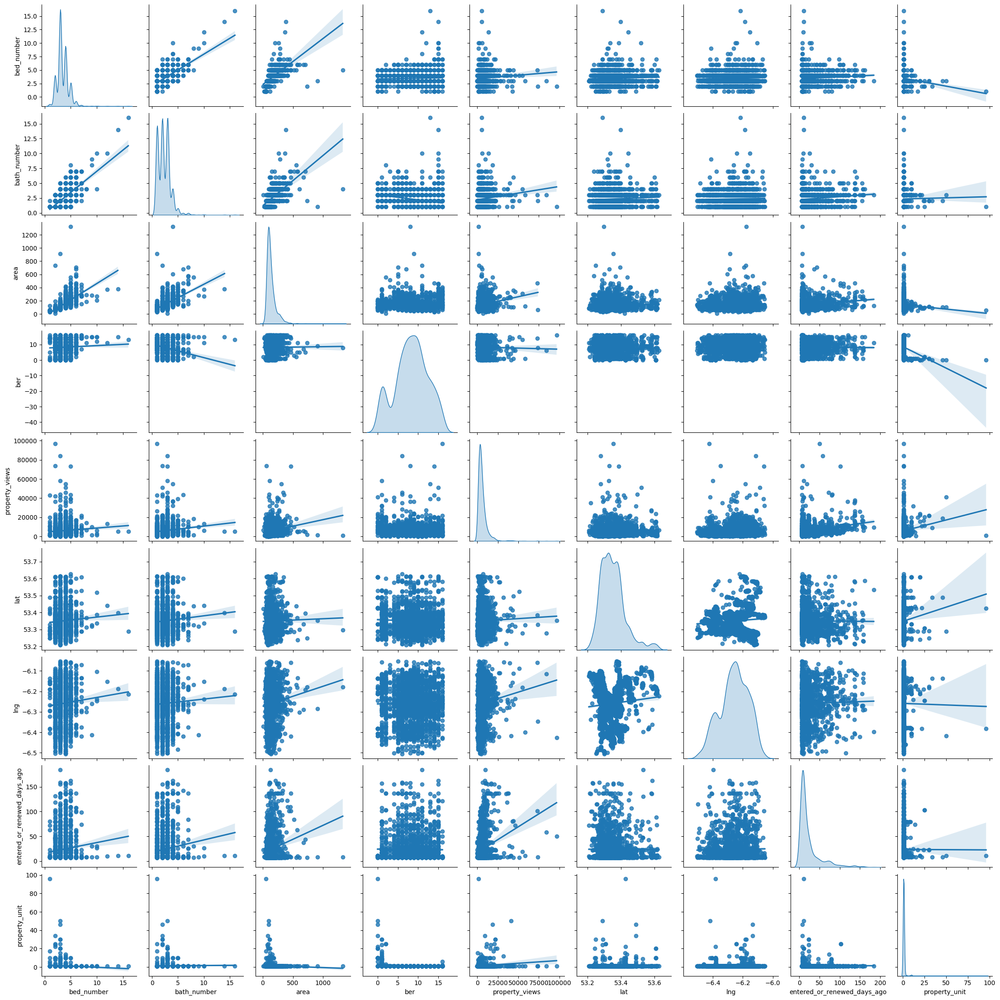

In [18]:
import seaborn as sns

# Convert infinite values to NaN
general_features_df = features[general_features_columns].copy()
general_features_df.replace([np.inf, -np.inf], np.nan, inplace=True)
sns.pairplot(general_features_df, kind="reg", diag_kind="kde")
plt.savefig('FeatureEngineering/2.general_features_pairplot.jpg')

plt.show()

<h4>Some foundings</h4>
<ol>
    <li>Bedroom number and bathroom number indeed have strong correlation</li>
    <li>Bedroom number and BER is positive correlated, but Bathroom number and BER is negative correlated</li>
    <li>Most of the features follow poisson distribution, and if we later use linear based models, a guassion-like distributed model will be needed, power transform like Box-Cox Transformation or Yeo-Johnson Transformation will be needed. </li>
</ol>

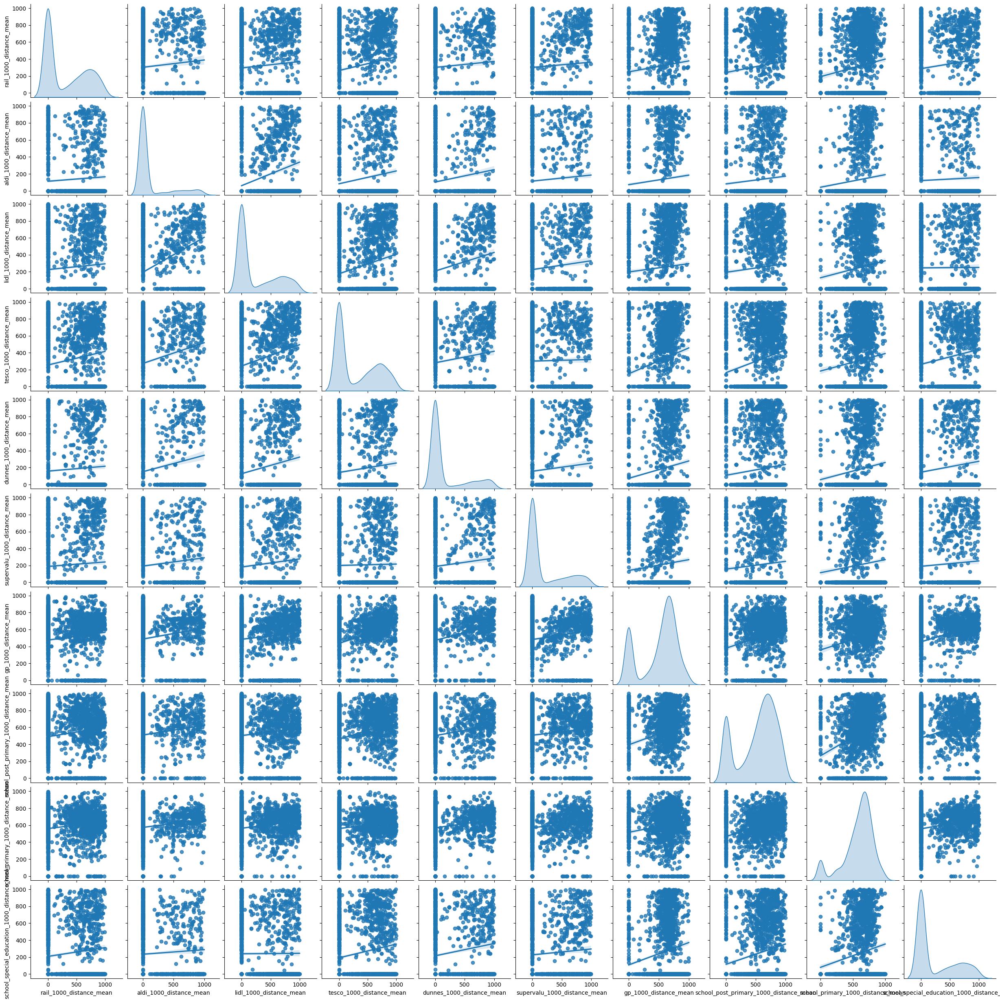

In [19]:
filtered_features_columns = [item for item in features.columns if (item.endswith('1000_distance_mean'))]
filtered_features = features[filtered_features_columns].copy()
filtered_features.replace([np.inf, -np.inf], np.nan, inplace=True)
sns.pairplot(filtered_features, kind="reg", diag_kind="kde")
plt.savefig('FeatureEngineering/3.distance_1k_mean_pairplot.jpg')

plt.show()

### Data Imputation

In [20]:
for column in features.columns:
    feature_number = sum(pd.notna(features[column]))
    missing_percentage = (1 - feature_number / len(features)) * 100
    if missing_percentage != 0:
        print(f'{column} misses {len(features) - feature_number} records, missing percentage: {missing_percentage :.2f}%')

bed_number misses 16 records, missing percentage: 0.80%
bath_number misses 48 records, missing percentage: 2.41%
area misses 238 records, missing percentage: 11.94%


### Data Imputation Stategies

<p>From basic statistics 1 contour plots, we can find there are a lot correlation between bedroom and bathroom.</p> 
<p>For <strong>new house</strong>, bedroom and bathroom ratio is towards <strong>n: n</strong>.</p>
<p>For <strong>old house</strong>, bedroom and bathroom ratio is tender to be <strong>n+1: n</strong>.</p>
<p>From feature engineering 1 correlation coefficient, bedroom and bathroom both have some covariance with area, r<sup>2</sup> is around 0.6 - 0.7, though not strong.</p>
<br>
<p>In this case, we are aware that bedroom, bathroom, area and whether it is a new house have some inner links and can be used for data imputation, here we use <strong>KNN (Euclidean metrics)</strong> for this intrinsic feature.</p>
<br>
<p>Be noticed: KNNImputer use a variant of the Euclidean distance specifically designed to handle missing values, called nan_euclidean</p>
<p>Euclidean distance:</p>
$
\text{distance}(p, q) = \sqrt{\sum_{i=1}^{n} (p_i - q_i)^2} 
$
<p>nan_euclidean distance:</p>
$
\text{distance}(p, q) = \sqrt{\frac{\sum_{i=1}^{n} (p_i - q_i)^2}{\text{number of non-missing dimensions}}}
$

### KNNImputer

#### KNNImputer is based on KNN, and need to confirm k (neighbors) first.

In [21]:
from sklearn.impute import KNNImputer
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split

# extract bathroom, area and whether it is a new house to a new data frame
missing_value_df = features[['bed_number', 'bath_number', 'area', 'new_house']]
missing_value_df.loc[missing_value_df.index, 'new_house'] = missing_value_df['new_house'].apply(lambda x: 1 if x=='Yes' else 0)

# Split data into training and validation sets
train_data, val_data = train_test_split(missing_value_df, test_size=0.2, random_state=42)

# Define range for `n_neighbors`
n_neighbors_list = np.arange(1, 20)

best_n_neighbors = None
best_score = float('inf')

for n_neighbors in n_neighbors_list:
    imputer = KNNImputer(n_neighbors=n_neighbors)
    imputed_data = imputer.fit_transform(train_data)
    
    # Compute metrics on validation data
    val_imputed = imputer.transform(val_data)
    
    # Calculate a simple metric (e.g., MSE)
    # Here we are just using the mean squared error for demonstration purposes

    # Infer objects explicitly to handle future changes
    val_data_inferred = val_data.infer_objects()

    mse = mean_squared_error(val_data_inferred.fillna(0), val_imputed)  # Placeholder metric
    print(f'n_neighbors: {n_neighbors}, MSE: {mse}')
    
    if mse < best_score:
        best_score = mse
        best_n_neighbors = n_neighbors

print(f'Best n_neighbors: {best_n_neighbors}')

n_neighbors: 1, MSE: 547.9636591478696
n_neighbors: 2, MSE: 570.34335839599
n_neighbors: 3, MSE: 556.59335839599
n_neighbors: 4, MSE: 468.37096647869674
n_neighbors: 5, MSE: 528.1928571428572
n_neighbors: 6, MSE: 509.62874199387363
n_neighbors: 7, MSE: 514.3701473070431
n_neighbors: 8, MSE: 501.0211368264411
n_neighbors: 9, MSE: 503.3272765246449
n_neighbors: 10, MSE: 519.4937531328321
n_neighbors: 11, MSE: 510.00286356386835
n_neighbors: 12, MSE: 513.4531989696462
n_neighbors: 13, MSE: 516.3728440924798
n_neighbors: 14, MSE: 512.6584381873051
n_neighbors: 15, MSE: 525.8902422723476
n_neighbors: 16, MSE: 523.9255781054198
n_neighbors: 17, MSE: 512.7217936710288
n_neighbors: 18, MSE: 507.54925314830285
n_neighbors: 19, MSE: 505.4035365421865
Best n_neighbors: 4


<br>
<p>Quick Recap on KNN</p>
<p>K-Nearest Neighbors (KNN) can be considered both supervised and unsupervised, depending on the context in which it is used.</p>
<p>For unsupervised learning algorithm, <strong>imputation</strong> is one of the main use cases</p>
<p>KNN can be used in an unsupervised fashion for data imputation. Here, it helps to fill in missing values in a dataset by finding the nearest neighbors of a data point and using their values to estimate the missing ones.</p>
<p>Here are steps how KNN works</p>
<ol>
    <li>Calculate (Euclidean) Distance.</li>
    <li>Get Nearest Neighbors.</li>
    <li>Make Predictions</li>
</ol>

### Train & test split

In [22]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(features, label, train_size=0.8)
print(f'Train feature shape: {X_train.shape}')
print(f'Train target shape: {y_train.shape}')
print(f'Test feature shape: {X_test.shape}')
print(f'Test target shape: {y_test.shape}')

Train feature shape: (1594, 41)
Train target shape: (1594,)
Test feature shape: (399, 41)
Test target shape: (399,)


### Feature Split

In [23]:
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import PowerTransformer
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, OneHotEncoder

# categorical columns
categorical_columns = ['house_type', 'new_house']

# numerical columns
missing_value_columns = ['bed_number', 'bath_number', 'area']
geolocation_columns = ['lat', 'lng']
numerical_columns = features.columns
numerical_columns = [column for column in numerical_columns.drop(categorical_columns + missing_value_columns + geolocation_columns) 
                     if 'unit' not in column]

# numerical and categorical pipeline
missing_value_preprocessor = Pipeline(
    steps=[
        ("KNNImputer", KNNImputer(n_neighbors=best_n_neighbors)),
        ('PT', PowerTransformer(method='yeo-johnson')),
        ("STD", StandardScaler()),
    ]
)

geolocation_preprocessor = Pipeline(
    steps=[
        ("STD", StandardScaler()),
    ]
)

numerical_preprocessor = Pipeline(
    steps=[
        ('PT', PowerTransformer(method='yeo-johnson')),
        ("STD", StandardScaler()),
    ]
)

categorical_preprocessor = Pipeline(
    steps=[
        ("OneHot", OneHotEncoder(handle_unknown='ignore')),
    ]
)

preprocessor = ColumnTransformer(
    [
        ("categorical", categorical_preprocessor, categorical_columns),
        ("numerical_missing_value", missing_value_preprocessor, missing_value_columns),
        ("numerical_geolocation", geolocation_preprocessor, geolocation_columns),
        ("numerical", numerical_preprocessor, numerical_columns),
    ]
)

feature_engineering_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor)
    ]
)

preprocessor.fit(X_train, y_train)
X_processed = preprocessor.transform(X_train)
print(f'After feature process, the scaled data shape: {X_processed.shape}')
preprocessor

After feature process, the scaled data shape: (1594, 48)


ColumnTransformer(transformers=[('categorical',
                                 Pipeline(steps=[('OneHot',
                                                  OneHotEncoder(handle_unknown='ignore'))]),
                                 ['house_type', 'new_house']),
                                ('numerical_missing_value',
                                 Pipeline(steps=[('KNNImputer',
                                                  KNNImputer(n_neighbors=4)),
                                                 ('PT', PowerTransformer()),
                                                 ('STD', StandardScaler())]),
                                 ['bed_number', 'bath_number', 'area']),
                                ('numerical_geolocation',
                                 Pipeline...
                                  'supervalu_3000_distance_mean',
                                  'supervalu_5000_distance_mean',
                                  'gp_1000_distance_mean',
                                  'gp_3000_distance_mean',
                                  'gp_5000_distance_mean',
                                  'school_post_primary_1000_distance_mean',
                                  'school_post_primary_3000_distance_mean',
                                  'school_post_primary_5000_distance_mean',
                                  'school_primary_1000_distance_mean',
                                  'school_primary_3000_distance_mean',
                                  'school_primary_5000_distance_mean', ...])])

### Dimensionality Reduction

#### PCA with Explained Variance

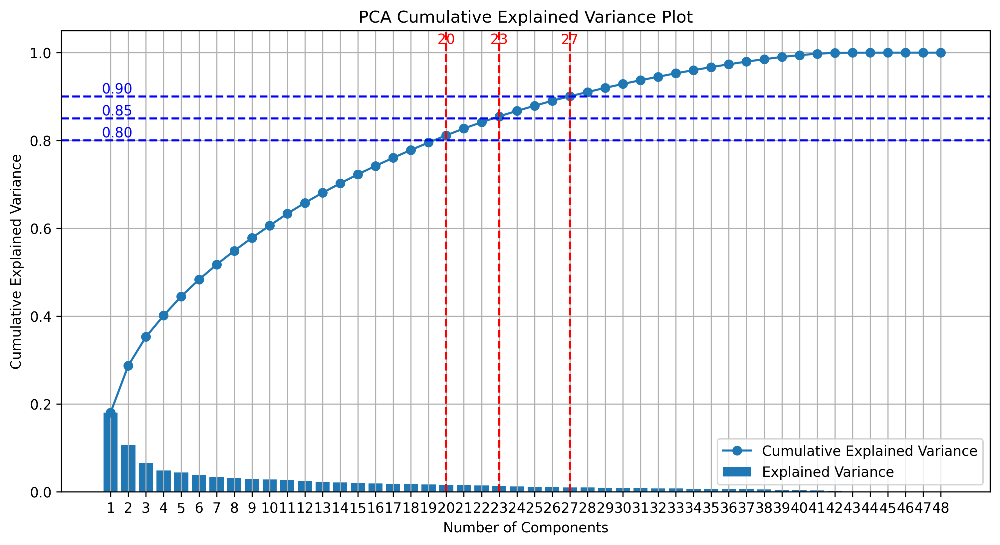

In [24]:
from sklearn.decomposition import PCA

pca = PCA()
X_pca = pca.fit_transform(X_processed)

# Explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_

# Cumulative explained variance
cumulative_explained_variance = np.cumsum(explained_variance_ratio)

# Find indices where cumulative explained variance just surpasses 0.8 and 0.85
thresholds = [0.8, 0.85, 0.9]
indices = [np.where(cumulative_explained_variance >= t)[0][0] for t in thresholds]

# Plot cumulative explained variance
plt.figure(figsize=(12, 6), dpi=300)
plt.plot(cumulative_explained_variance, marker='o', label='Cumulative Explained Variance')
cumsum_ev_len = len(explained_variance_ratio)
plt.bar(np.arange(cumsum_ev_len), explained_variance_ratio, label='Explained Variance')
plt.xticks(np.arange(cumsum_ev_len), labels=np.arange(1, cumsum_ev_len+1))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('PCA Cumulative Explained Variance Plot')

# Add vertical and horizontal lines at the specified thresholds
for idx, threshold in zip(indices, thresholds):
    plt.axvline(x=idx, color='r', linestyle='--')
    plt.axhline(y=threshold, color='b', linestyle='--')
    plt.text(idx, 1.02, f'{idx+1}', color='r', ha='center')
    plt.text(-0.5, threshold, f'{threshold:.2f}', color='b', va='bottom')

plt.grid(True)
plt.legend()
plt.savefig('FeatureEngineering/4.PCA_explained_variance.jpg')

plt.show()

In [25]:
# Define the threshold
threshold = 0.85

# Find the index of the first value greater than the threshold
threshold_index = next(i for i, value in enumerate(cumulative_explained_variance) if value > threshold)

print(f"The minimum index with value just beyond {threshold} is {threshold_index}.")
print(f'There are {X_processed.shape[1]} features for the {X_processed.shape[0]} records.')

The minimum index with value just beyond 0.85 is 22.
There are 48 features for the 1594 records.


<p>There are 49 features for the 1594 records, and PC1 (Principal Component) is not dominant among the other PCs, which means after linear Singular Value Decomposition (SVD) process, each feature contributes tiny to every PC, we can examine this assumption below.</p>
<br>
<p>A quick recap for the mathematics behind PCA</p>
<ol>
    <li>Substract the mean of each variable.</li>
    <li>Calculate the covariance matrix.</li>
    <li>Compute eigenvectors and eigenvlaues.</li>
    <li>Sort eigenvalues in descending orders.</li>
    <li>Select a subset from the rearranged eigenvalue matrix.</li>
    <li>Transform the data.</li>
</ol>

#### PCA Loadings

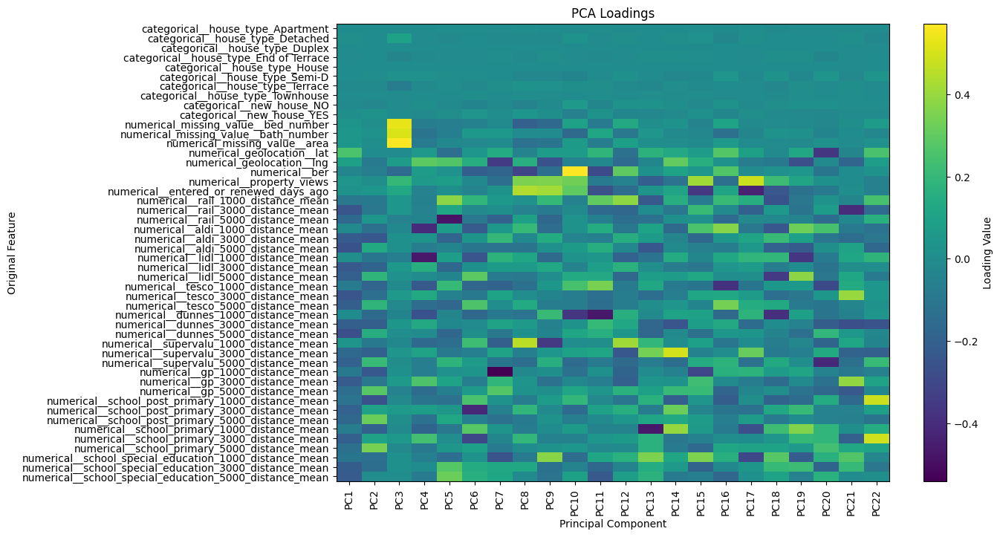

In [26]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Suppose you have fitted PCA already
pca = PCA(n_components=threshold_index)
X_train_pca = pca.fit_transform(X_processed)

# Access the PCA components
components = pca.components_

# Feature names from the original data
feature_names = preprocessor.get_feature_names_out()

# Create a DataFrame to view component loadings
pca_loadings = pd.DataFrame(
    components.T,  # Transpose so that features are rows
    index=feature_names,
    columns=[f'PC{i+1}' for i in range(components.shape[0])]
)

# Print PCA loadings
# print(pca_loadings)

# Visualize component loadings (if desired)
plt.figure(figsize=(12, 8))
plt.imshow(pca_loadings, aspect='auto', cmap='viridis')
plt.colorbar(label='Loading Value')
plt.xlabel('Principal Component')
plt.ylabel('Original Feature')
plt.title('PCA Loadings')
plt.yticks(ticks=np.arange(len(feature_names)), labels=feature_names)
plt.xticks(ticks=np.arange(pca_loadings.shape[1]), labels=[f'PC{i+1}' for i in range(pca_loadings.shape[1])], rotation=90)
plt.savefig('FeatureEngineering/5.PCA_loadings.jpg', bbox_inches='tight', dpi=300)
plt.show()

<p>When you use PCA for dimensionality reduction, the resulting principal components are linear combinations of the original features. After applying PCA, the transformed data no longer directly corresponds to the original feature names. However, you can still interpret the principal components in terms of the original features by examining the <strong>component loadings</strong>.</p>
<br>
<p>Notes:</p>
<ul>
    <li>Loadings Interpretation:</li>
    <ul>
        <li>Large positive or negative values in the loadings indicate a strong relationship between the original feature and the principal component.</li>
    </ul>
</ul>
<br>

<p>The above PCA loadings colormap confirms our assumptions, the original features contributes every PCs tiny, and its hard to say which features contribute most to PC1, PC2 etc. there is no straight forward mapping between original features principal components, but on the other hand, it says our selection on features is relatively good.</p>
<p>Considering the situation not too many features, and no straight forward mappings, we could <strong>discard PCA</strong> for dimensionality reduction, which also leaves a good explainablity from business perspective.</p>

## Feature Engineering Pipeline

In [27]:
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder

# categorical columns
categorical_columns = ['house_type', 'new_house']

# numerical columns
missing_value_columns = ['bed_number', 'bath_number', 'area']
geolocation_columns = ['lat', 'lng']
numerical_columns = features.columns
numerical_columns = [column for column in numerical_columns.drop(categorical_columns + missing_value_columns + geolocation_columns) 
                     if 'unit' not in column]

# numerical and categorical pipeline
missing_value_preprocessor = Pipeline(
    steps=[
        ("KNNImputer", KNNImputer(n_neighbors=best_n_neighbors)),
        ('PT', PowerTransformer(method='yeo-johnson')),
        ("STD", StandardScaler()),
    ]
)

geolocation_preprocessor = Pipeline(
    steps=[
        ("STD", StandardScaler()),
    ]
)

numerical_preprocessor = Pipeline(
    steps=[
        ('PT', PowerTransformer(method='yeo-johnson')),
        ("STD", StandardScaler()),
    ]
)

categorical_preprocessor = Pipeline(
    steps=[
        ("OneHot", OneHotEncoder(handle_unknown='ignore')),
    ]
)

preprocessor = ColumnTransformer(
    [
        ("categorical", categorical_preprocessor, categorical_columns),
        ("numerical_missing_value", missing_value_preprocessor, missing_value_columns),
        ("numerical_geolocation", geolocation_preprocessor, geolocation_columns),
        ("numerical", numerical_preprocessor, numerical_columns),
    ]
)

feature_engineering_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor)
    ]
)

# feature_engineering_pipeline

feature_engineering_pipeline.fit(X_train, y_train)
X_processed = feature_engineering_pipeline.transform(X_train)
print(f'After feature process, the scaled data shape: {X_processed.shape}')
feature_engineering_pipeline

After feature process, the scaled data shape: (1594, 48)


Pipeline(steps=[('preprocessor',
                 ColumnTransformer(transformers=[('categorical',
                                                  Pipeline(steps=[('OneHot',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  ['house_type', 'new_house']),
                                                 ('numerical_missing_value',
                                                  Pipeline(steps=[('KNNImputer',
                                                                   KNNImputer(n_neighbors=4)),
                                                                  ('PT',
                                                                   PowerTransformer()),
                                                                  ('STD',
                                                                   StandardScaler())]),
                                                  ['bed_number', 'bath_number',
                                                   'area']),
                                                 (...
                                                   'supervalu_3000_distance_mean',
                                                   'supervalu_5000_distance_mean',
                                                   'gp_1000_distance_mean',
                                                   'gp_3000_distance_mean',
                                                   'gp_5000_distance_mean',
                                                   'school_post_primary_1000_distance_mean',
                                                   'school_post_primary_3000_distance_mean',
                                                   'school_post_primary_5000_distance_mean',
                                                   'school_primary_1000_distance_mean',
                                                   'school_primary_3000_distance_mean',
                                                   'school_primary_5000_distance_mean', ...])]))])

# Modeling

### 1. Linear Model (ElasticNet)

In [28]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.linear_model import ElasticNet

# Define the pipeline with Logistic Regression
lr_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('regressor', ElasticNet())
    ]
)

# Define the parameter grid for GridSearchCV
param_grid = {
    'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': np.arange(10, 15),
    'regressor__alpha': [0.1, 1.0, 10.0],  # Regularization strength
    'regressor__l1_ratio': [0.1, 0.5, 0.9]  # Balance between L1 and L2
}

# Define KFold
stratified_cv = KFold(n_splits=5)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=lr_pipeline,
    param_grid=param_grid,
    cv=stratified_cv,  # Number of cross-validation folds
    scoring='neg_mean_absolute_percentage_error',
    n_jobs=-1,  # Use all available cores
    verbose=1  # Print progress messages
)

# Fit the GridSearchCV
grid_search.fit(X_train, y_train)

# Print best parameters and score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: ", grid_search.best_score_)
lr_grid_search = grid_search
lr_grid_search

Fitting 5 folds for each of 45 candidates, totalling 225 fits
Best parameters found:  {'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': 14, 'regressor__alpha': 0.1, 'regressor__l1_ratio': 0.1}
Best cross-validation score:  -0.02006181193148368


GridSearchCV(cv=KFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('OneHot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['house_type',
                                                                          'new_house']),
                                                                        ('numerical_missing_value',
                                                                         Pipeline(steps=[('KNNImputer',
                                                                                          KNNImputer(n_neighbors=4)),
                                                                                         ('PT',
                                                                                          PowerTran...
                                                                          'school_primary_1000_distance_mean',
                                                                          'school_primary_3000_distance_mean',
                                                                          'school_primary_5000_distance_mean', ...])])),
                                       ('regressor', ElasticNet())]),
             n_jobs=-1,
             param_grid={'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': array([10, 11, 12, 13, 14]),
                         'regressor__alpha': [0.1, 1.0, 10.0],
                         'regressor__l1_ratio': [0.1, 0.5, 0.9]},
             scoring='neg_mean_absolute_percentage_error', verbose=1)

<p>Previously, when we examine PCA loadings, some features at the very top of diagram shows no variance contributed, or more frankly, those features are kind of uselsess to some extent, and can be shrinkaged. This indeed match perfectly with Lasso (Least Absolute Shrinkage and Selection Operator); Be noticed that the features at the bottom, most of the variables are useful, in this case, Ridge will be a good choice. Thus leaves us some thinkings to combine them two together (<strong>ElasticNet</strong>), and when combining, we need to quantify the ratio of each model and the strengh, grid search with cross validation will do this job for us.</p>
<br>
<p>A quick recap for the Linear models</p>
<p>Basic linear model is OLS (Ordinary Least Squares), whose optimized approach is gradient descent. As sample space is not always linear distributed or saparable, some samples may be convex or concave at higher affiline spaces. Thus some regulations can be used to minimize those errors, for technique terms, the regulations is called 'penalty' and errors are usually based on 'Sum of Squared Errors' (SSR). Two common panelties are absolute and squared the slopes' coefficients, which are L1 norm (used by Lasso) and L2 norm (used by Ridge) separately.</p>
<br>
<p>A comparison on these 2 methods</p>
<ol>
    <li>Lasso (Least Absolute Shrinkage and Selection Operator)</li>
        <ul>
            <li>penalty = λ ∗(|slope<sub>1</sub> | + |slope<sub>2</sub> |  + … )</li>
            <li>If the slope is not useful in equition, Lasso can shrink the absolute slope all the way to 0, thus exclude some useless features.</li>
        </ul>
    <li>Ridge</li>
    <ul>
        <li>penalty = λ (slope<sub>1</sub><sup>2</sup> + slope<sub>2</sub><sup>2</sup> + slope<sub>3</sub><sup>2</sup> + … )</li>
        <li>When the sample sizes are relatively small, then ridge regression can improve predictions made from new data (i.e. reduce variance) by making the prediction less sensitive to the training data.</li>
        <li>Ridge regression works best when most of the variables in the model are useful.</li>
    </ul>
</ol>

train pred: mse: 0.1107, mape: 0.0199
pred: mse: 0.1107, mape: 0.0198


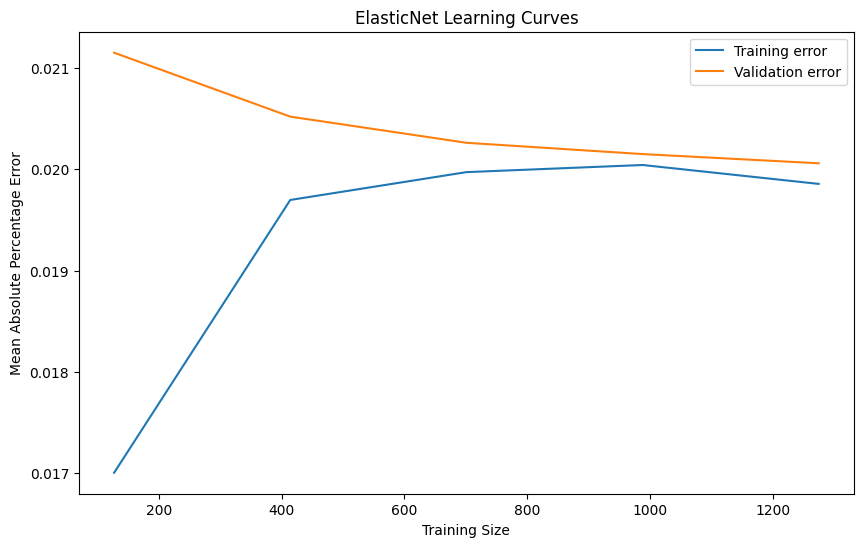

In [29]:
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error
from sklearn.model_selection import learning_curve

def calculate_metric_mape(model, X_train, X_test, y_train, y_test):
    y_pred = model.predict(X_train)
    train_mse = mean_squared_error(y_pred, y_train)
    train_mape = mean_absolute_percentage_error(y_pred, y_train)
    print(f'train pred: mse: {train_mse:.4f}, mape: {train_mape:.4f}')

    y_test_pred = model.predict(X_test)
    test_mse = mean_squared_error(y_test_pred, y_test)
    test_mape = mean_absolute_percentage_error(y_test_pred, y_test)
    print(f'pred: mse: {test_mse:.4f}, mape: {test_mape:.4f}')

    return train_mape, test_mape

def view_metric_plot(model, model_name, X_train, X_test):

    # Plot learning curves
    train_sizes, train_scores, val_scores = learning_curve(
        estimator=model.best_estimator_,
        X=X_train,
        y=y_train,
        cv=5,
        scoring='neg_mean_absolute_percentage_error',
        n_jobs=-1
    )

    train_scores_mean = -train_scores.mean(axis=1)
    val_scores_mean = -val_scores.mean(axis=1)

    plt.figure(figsize=(10, 6))
    plt.plot(train_sizes, train_scores_mean, label='Training error')
    plt.plot(train_sizes, val_scores_mean, label='Validation error')
    plt.xlabel('Training Size')
    plt.ylabel('Mean Absolute Percentage Error')
    plt.title(f'{model_name} Learning Curves')
    plt.legend()
    plt.show()

    
calculate_metric_mape(lr_grid_search, X_train, X_test, y_train, y_test)
view_metric_plot(lr_grid_search, 'ElasticNet', X_train, X_test)

<p>As we remain the test set untouched, we need a validation set to fine tune the parameters, and observe the errors from both training set and validation sets.</p>
<p>From learning curve, our model seems not overfitting, neither underfitting, but the data set all comes from original training set. When we use test set, both mse and mape goes up and show signs of overfitting. One possible reason may be too many features as we choose not to trim features.</p>

### 2. Decision Tree (CART)

In [30]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.tree import DecisionTreeRegressor

# Define the pipeline with Logistic Regression
dt_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('regressor', DecisionTreeRegressor())
    ]
)

# Define the parameter grid for GridSearchCV
param_grid = {
    'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': np.arange(10, 15),
    'regressor__max_depth': np.arange(1, int(np.sqrt(22)))
}

# Define KFold
stratified_cv = KFold(n_splits=5)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=dt_pipeline,
    param_grid=param_grid,
    cv=stratified_cv,  # Number of cross-validation folds
    scoring='neg_mean_absolute_percentage_error',
    n_jobs=-1,  # Use all available cores
    verbose=1  # Print progress messages
)

# Fit the GridSearchCV
grid_search.fit(X_train, y_train)

# Print best parameters and score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: ", grid_search.best_score_)

y_pred = grid_search.predict(X_train)
mse = mean_squared_error(y_pred, y_train)
mape = mean_absolute_percentage_error(y_pred, y_train)
print(f'train pred: mse: {mse:.2f}, mape: {mape:.2f}')

y_test_pred = grid_search.predict(X_test)
mse = mean_squared_error(y_test_pred, y_test)
mape = mean_absolute_percentage_error(y_test_pred, y_test)
print(f'pred: mse: {mse:.2f}, mape: {mape:.2f}')
dt_grid_search = grid_search
dt_grid_search

Fitting 5 folds for each of 15 candidates, totalling 75 fits
Best parameters found:  {'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': 12, 'regressor__max_depth': 3}
Best cross-validation score:  -0.0188514121781942
train pred: mse: 0.09, mape: 0.02
pred: mse: 0.11, mape: 0.02


GridSearchCV(cv=KFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('OneHot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['house_type',
                                                                          'new_house']),
                                                                        ('numerical_missing_value',
                                                                         Pipeline(steps=[('KNNImputer',
                                                                                          KNNImputer(n_neighbors=4)),
                                                                                         ('PT',
                                                                                          PowerTran...
                                                                          'school_primary_1000_distance_mean',
                                                                          'school_primary_3000_distance_mean',
                                                                          'school_primary_5000_distance_mean', ...])])),
                                       ('regressor', DecisionTreeRegressor())]),
             n_jobs=-1,
             param_grid={'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': array([10, 11, 12, 13, 14]),
                         'regressor__max_depth': array([1, 2, 3])},
             scoring='neg_mean_absolute_percentage_error', verbose=1)

train pred: mse: 0.0934, mape: 0.0180
pred: mse: 0.1127, mape: 0.0198


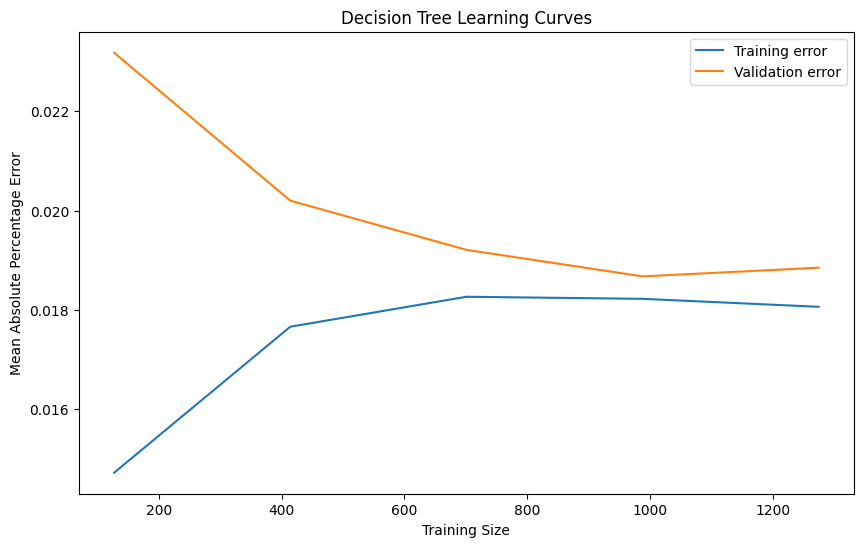

In [31]:
calculate_metric_mape(dt_grid_search, X_train, X_test, y_train, y_test)
view_metric_plot(dt_grid_search, 'Decision Tree', X_train, X_test)

<p>From learning curve, train and validation error asymptotically together, train and test mse and mape are matched, CART decision tree seems a good choice.</p>
<br>
<p>What about the ensemble trees? Random Forest?</p>

### 3. Random Forest

In [32]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.ensemble import RandomForestRegressor

# Define the pipeline with Logistic Regression
rf_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('classifier', RandomForestRegressor(n_jobs=-1, n_estimators=1000))
    ]
)

# Define the parameter grid for GridSearchCV
param_grid = {
    'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': np.arange(10, 15),
    'classifier__max_depth': np.arange(1, int(np.sqrt(22)))
}

# Define KFold
stratified_cv = KFold(n_splits=3)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=rf_pipeline,
    param_grid=param_grid,
    cv=stratified_cv,  # Number of cross-validation folds
    scoring='neg_mean_absolute_percentage_error',
    n_jobs=-1,  # Use all available cores
    verbose=1  # Print progress messages
)

# Fit the GridSearchCV
grid_search.fit(X_train, y_train)

# Print best parameters and score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: ", grid_search.best_score_)

y_pred = grid_search.predict(X_train)
mse = mean_squared_error(y_pred, y_train)
mape = mean_absolute_percentage_error(y_pred, y_train)
print(f'train pred: mse: {mse:.2f}, mape: {mape:.2f}')

y_test_pred = grid_search.predict(X_test)
mse = mean_squared_error(y_test_pred, y_test)
mape = mean_absolute_percentage_error(y_test_pred, y_test)
print(f'pred: mse: {mse:.2f}, mape: {mape:.2f}')
rf_grid_search = grid_search
rf_grid_search

Fitting 3 folds for each of 15 candidates, totalling 45 fits
Best parameters found:  {'classifier__max_depth': 3, 'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': 14}
Best cross-validation score:  -0.018535806891238935
train pred: mse: 0.09, mape: 0.02
pred: mse: 0.11, mape: 0.02


GridSearchCV(cv=KFold(n_splits=3, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('OneHot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['house_type',
                                                                          'new_house']),
                                                                        ('numerical_missing_value',
                                                                         Pipeline(steps=[('KNNImputer',
                                                                                          KNNImputer(n_neighbors=4)),
                                                                                         ('PT',
                                                                                          PowerTran...
                                                                          'school_primary_3000_distance_mean',
                                                                          'school_primary_5000_distance_mean', ...])])),
                                       ('classifier',
                                        RandomForestRegressor(n_estimators=1000,
                                                              n_jobs=-1))]),
             n_jobs=-1,
             param_grid={'classifier__max_depth': array([1, 2, 3]),
                         'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': array([10, 11, 12, 13, 14])},
             scoring='neg_mean_absolute_percentage_error', verbose=1)

train pred: mse: 0.0889, mape: 0.0178
pred: mse: 0.1050, mape: 0.0191


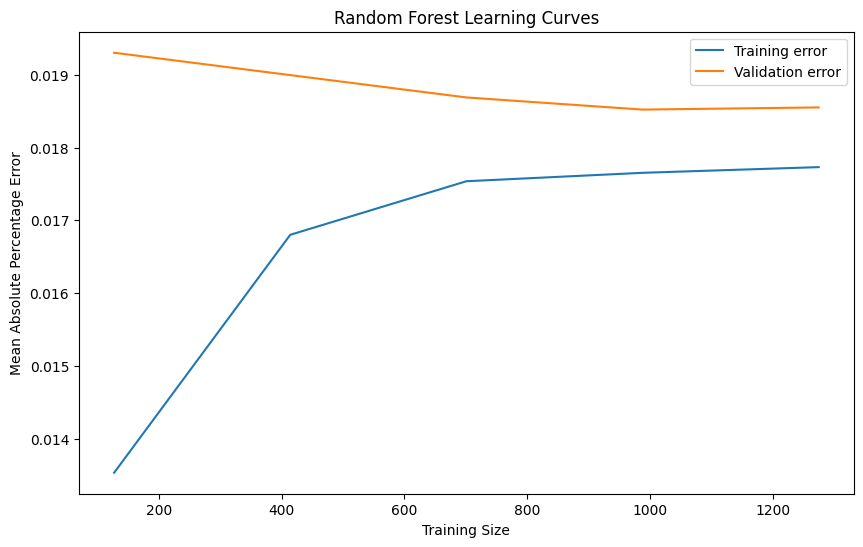

In [33]:
calculate_metric_mape(rf_grid_search, X_train, X_test, y_train, y_test)
view_metric_plot(rf_grid_search, 'Random Forest', X_train, X_test)

<p> Random forest perform almost as good as decision tree, but performace is much slower, and anther thing needs to be considered that random forest is more likely to be overfitting, so decision tree is relatively better than random forest in this scenario.</p>
<br>
<p>As our sample space is not too big, we can also try out manifold method, SVM (Support Vector Machine)</p>

### 4. Support Vector Regressor (SVR)

In [34]:
from sklearn.model_selection import GridSearchCV, KFold
from sklearn.svm import SVR

# Define the pipeline with Logistic Regression
svr_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('classifier', SVR())
    ]
)

# Define the parameter grid for GridSearchCV
param_grid = {
    'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': np.arange(10, 15),
    'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
}

# Define KFold
stratified_cv = KFold(n_splits=5)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=svr_pipeline,
    param_grid=param_grid,
    cv=stratified_cv,  # Number of cross-validation folds
    scoring='neg_mean_absolute_percentage_error',
    n_jobs=-1,  # Use all available cores
    verbose=1  # Print progress messages
)

# Fit the GridSearchCV
grid_search.fit(X_train, y_train)

# Print best parameters and score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: ", grid_search.best_score_)

y_pred = grid_search.predict(X_train)
mse = mean_squared_error(y_pred, y_train)
mape = mean_absolute_percentage_error(y_pred, y_train)
print(f'train pred: mse: {mse:.2f}, mape: {mape:.2f}')

y_test_pred = grid_search.predict(X_test)
mse = mean_squared_error(y_test_pred, y_test)
mape = mean_absolute_percentage_error(y_test_pred, y_test)
print(f'pred: mse: {mse:.2f}, mape: {mape:.2f}')
svr_grid_search = grid_search
svr_grid_search

Fitting 5 folds for each of 20 candidates, totalling 100 fits
Best parameters found:  {'classifier__kernel': 'linear', 'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': 14}
Best cross-validation score:  -0.01964088109841568
train pred: mse: 0.11, mape: 0.02
pred: mse: 0.12, mape: 0.02


GridSearchCV(cv=KFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('OneHot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['house_type',
                                                                          'new_house']),
                                                                        ('numerical_missing_value',
                                                                         Pipeline(steps=[('KNNImputer',
                                                                                          KNNImputer(n_neighbors=4)),
                                                                                         ('PT',
                                                                                          PowerTran...
                                                                          'school_primary_1000_distance_mean',
                                                                          'school_primary_3000_distance_mean',
                                                                          'school_primary_5000_distance_mean', ...])])),
                                       ('classifier', SVR())]),
             n_jobs=-1,
             param_grid={'classifier__kernel': ['linear', 'poly', 'rbf',
                                                'sigmoid'],
                         'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': array([10, 11, 12, 13, 14])},
             scoring='neg_mean_absolute_percentage_error', verbose=1)

train pred: mse: 0.1070, mape: 0.0189
pred: mse: 0.1188, mape: 0.0198


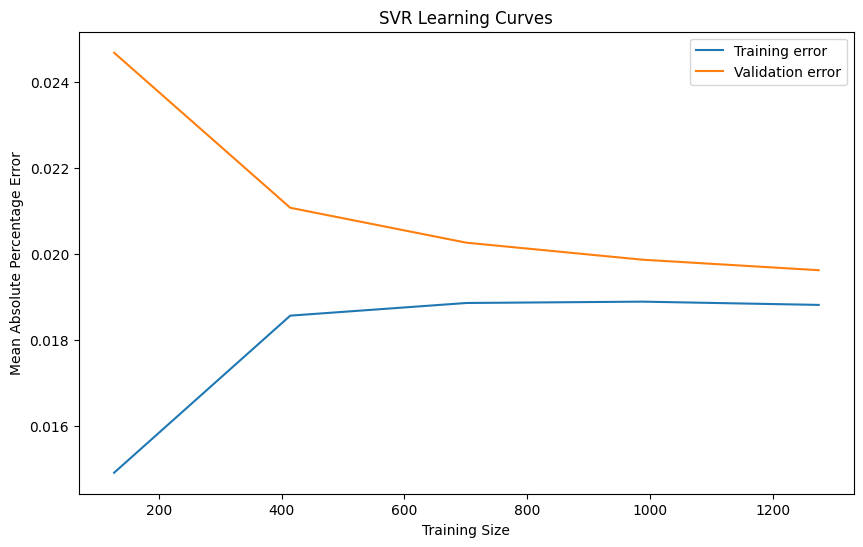

In [35]:
calculate_metric_mape(svr_grid_search, X_train, X_test, y_train, y_test)
view_metric_plot(svr_grid_search, 'SVR', X_train, X_test)

<p>Support Vector Regressor (SVR) does indeed converge asymptotically, but the training error, validation error, and test error are all high. This strongly indicates that SVR is underfitting, meaning the model is not sufficiently complex to address our problem.</p>
<p>Given that our sample size is relatively small, the low computational performance is acceptable.</p>
<br>
<p>The methods discussed above are either single models or bagging approaches. If we design a stacking method to combine the strengths of these models, could we achieve better performance? Let's find out.</p>

### 5. Stacking

In [36]:
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import StackingRegressor

estimators = [
    ('decision_tree', DecisionTreeRegressor()),
    ('svr', SVR())
]
regressor = StackingRegressor(
    estimators=estimators,
    final_estimator=ElasticNet(alpha=1, l1_ratio=0.5)
)


# Define the pipeline with Logistic Regression
stacking_pipeline = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('regressor', regressor)
    ]
)

# Define the parameter grid for GridSearchCV
param_grid = {
    'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': np.arange(10, 15),
    'regressor__decision_tree__max_depth': np.arange(1, 5),
    'regressor__svr__kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
}

# Define KFold
stratified_cv = KFold(n_splits=5)

# Initialize GridSearchCV
grid_search = GridSearchCV(
    estimator=stacking_pipeline,
    param_grid=param_grid,
    cv=stratified_cv,  # Number of cross-validation folds
    scoring='neg_mean_absolute_percentage_error',
    n_jobs=-1,  # Use all available cores
    verbose=1  # Print progress messages
)

# Fit the GridSearchCV
grid_search.fit(X_train, y_train)

# Print best parameters and score
print("Best parameters found: ", grid_search.best_params_)
print("Best cross-validation score: ", grid_search.best_score_)

y_pred = grid_search.predict(X_train)
mse = mean_squared_error(y_pred, y_train)
mape = mean_absolute_percentage_error(y_pred, y_train)
print(f'train pred: mse: {mse:.2f}, mape: {mape:.2f}')

y_test_pred = grid_search.predict(X_test)
mse = mean_squared_error(y_test_pred, y_test)
mape = mean_absolute_percentage_error(y_test_pred, y_test)
print(f'pred: mse: {mse:.2f}, mape: {mape:.2f}')
stacking_grid_search = grid_search
stacking_grid_search

Fitting 5 folds for each of 80 candidates, totalling 400 fits
Best parameters found:  {'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': 10, 'regressor__decision_tree__max_depth': 1, 'regressor__svr__kernel': 'linear'}
Best cross-validation score:  -0.03187404453548744
train pred: mse: 0.29, mape: 0.03
pred: mse: 0.29, mape: 0.03


GridSearchCV(cv=KFold(n_splits=5, random_state=None, shuffle=False),
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('categorical',
                                                                         Pipeline(steps=[('OneHot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['house_type',
                                                                          'new_house']),
                                                                        ('numerical_missing_value',
                                                                         Pipeline(steps=[('KNNImputer',
                                                                                          KNNImputer(n_neighbors=4)),
                                                                                         ('PT',
                                                                                          PowerTran...
                                                                       DecisionTreeRegressor()),
                                                                      ('svr',
                                                                       SVR())],
                                                          final_estimator=ElasticNet(alpha=1)))]),
             n_jobs=-1,
             param_grid={'preprocessor__numerical_missing_value__KNNImputer__n_neighbors': array([10, 11, 12, 13, 14]),
                         'regressor__decision_tree__max_depth': array([1, 2, 3, 4]),
                         'regressor__svr__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid']},
             scoring='neg_mean_absolute_percentage_error', verbose=1)

train pred: mse: 0.2896, mape: 0.0322
pred: mse: 0.2876, mape: 0.0321


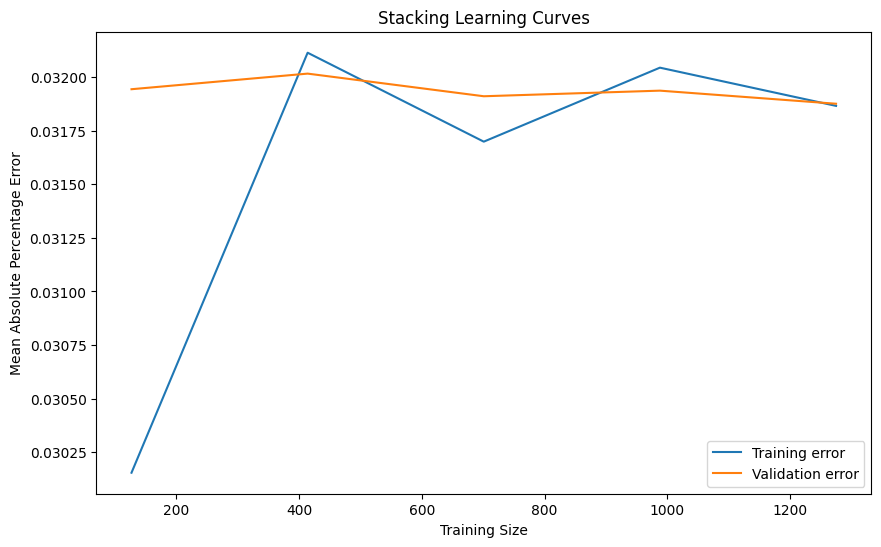

In [37]:
calculate_metric_mape(stacking_grid_search, X_train, X_test, y_train, y_test)
view_metric_plot(stacking_grid_search, 'Stacking', X_train, X_test)

## Model Metrics Summary

In [38]:
lr_train_mape, lr_test_mape = calculate_metric_mape(lr_grid_search, X_train, X_test, y_train, y_test)
dt_train_mape, dt_test_mape = calculate_metric_mape(dt_grid_search, X_train, X_test, y_train, y_test)
rf_train_mape, rf_test_mape = calculate_metric_mape(rf_grid_search, X_train, X_test, y_train, y_test)
svr_train_mape, svr_test_mape = calculate_metric_mape(svr_grid_search, X_train, X_test, y_train, y_test)
stacking_train_mape, stacking_test_mape = calculate_metric_mape(stacking_grid_search, X_train, X_test, y_train, y_test)

train_mape = [lr_train_mape, dt_train_mape, rf_train_mape, svr_train_mape, stacking_train_mape]
test_mape = [lr_test_mape, dt_test_mape, rf_test_mape, svr_test_mape, stacking_test_mape]
mape = pd.DataFrame({
    'model': ['Elastic Net', 'Decision Tree', 'Random Forest', 'SVR', 'Stacking'],
    'train MAPE': train_mape,
    'test MAPE': test_mape
})
mape

train pred: mse: 0.1107, mape: 0.0199
pred: mse: 0.1107, mape: 0.0198
train pred: mse: 0.0934, mape: 0.0180
pred: mse: 0.1127, mape: 0.0198
train pred: mse: 0.0889, mape: 0.0178
pred: mse: 0.1050, mape: 0.0191
train pred: mse: 0.1070, mape: 0.0189
pred: mse: 0.1188, mape: 0.0198
train pred: mse: 0.2896, mape: 0.0322
pred: mse: 0.2876, mape: 0.0321


,model,train MAPE,test MAPE
0,Elastic Net,0.019878,0.019768
1,Decision Tree,0.017972,0.019832
2,Random Forest,0.017772,0.019082
3,SVR,0.018897,0.019759
4,Stacking,0.032153,0.032089


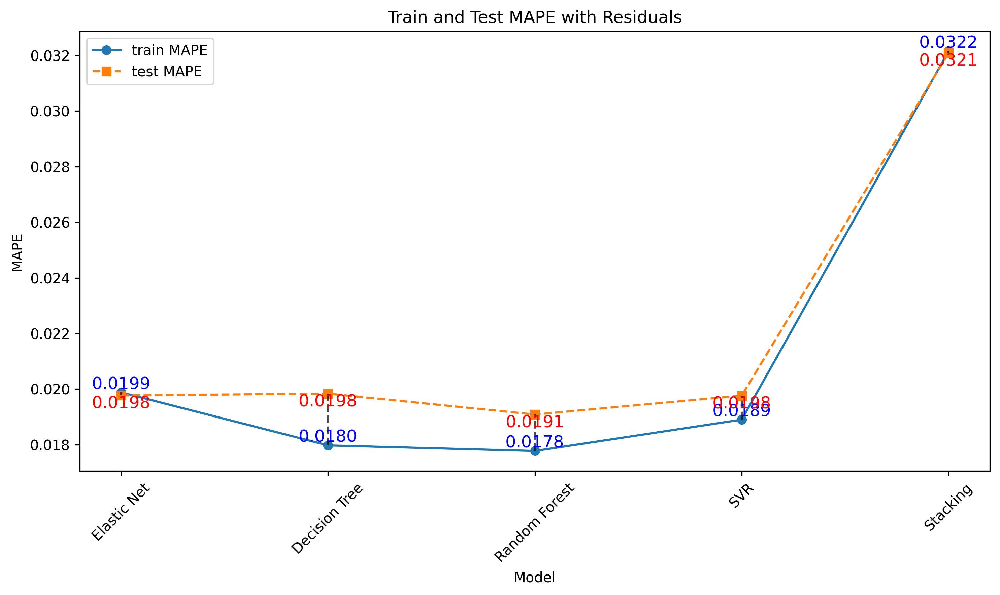

In [39]:
train_label = 'train MAPE'
test_label = 'test MAPE'

# Plot MAPE values
plt.figure(figsize=(10, 6), dpi=300)

# Plot train and test MAPE
plt.plot(mape[train_label], marker='o', label=train_label, linestyle='-')
plt.plot(mape[test_label], marker='s', label=test_label, linestyle='--')

# Add dashed lines connecting train and test MAPE
for i in range(len(mape)):
    plt.plot([i, i], [mape[train_label].iloc[i], mape[test_label].iloc[i]], 'k--', alpha=0.7)

# Mark residual values
for i in range(len(mape)):
    plt.text(i, mape[train_label].iloc[i], f'{mape[train_label].iloc[i]:.4f}', 
             ha='center', va='bottom', color='blue', fontsize=12)
    plt.text(i, mape[test_label].iloc[i], f'{mape[test_label].iloc[i]:.4f}', 
             ha='center', va='top', color='red', fontsize=12)

# Set x-ticks and labels
plt.xticks(np.arange(len(mape)), labels=mape['model'], rotation=45)

# Add legend and labels
plt.legend()
plt.xlabel('Model')
plt.ylabel('MAPE')
plt.title('Train and Test MAPE with Residuals')

# Display the plot
plt.tight_layout()
plt.savefig('Models/1.model_comparision_mape_residual.jpg')
plt.show()

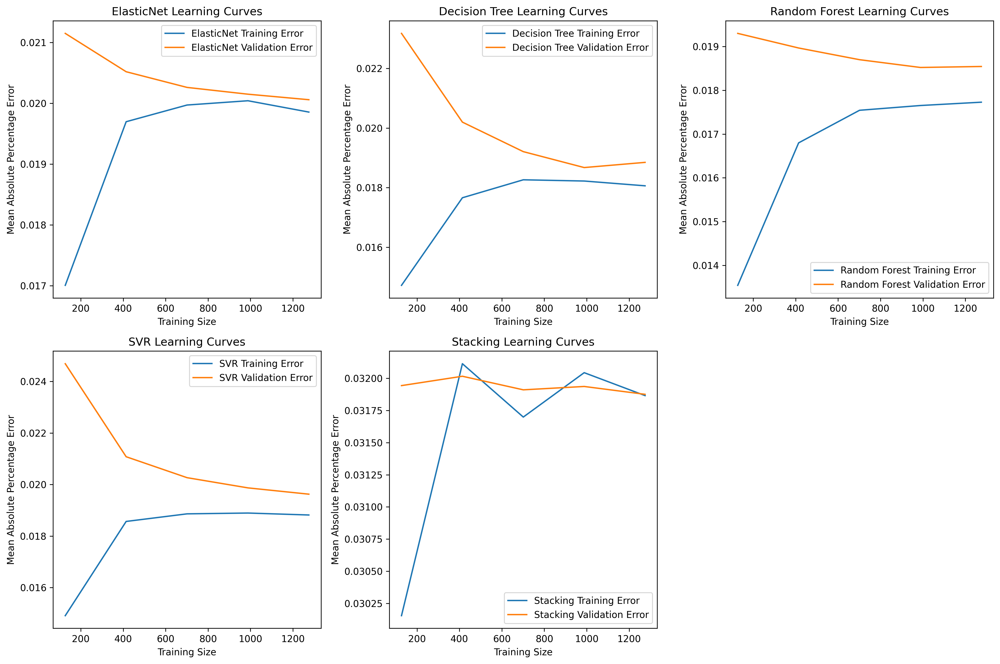

In [40]:
def view_metric_plot_subplot(model, model_name, X_train, X_test):

    # Plot learning curves
    train_sizes, train_scores, val_scores = learning_curve(
        estimator=model.best_estimator_,
        X=X_train,
        y=y_train,
        cv=5,
        scoring='neg_mean_absolute_percentage_error',
        n_jobs=-1
    )

    train_scores_mean = -train_scores.mean(axis=1)
    val_scores_mean = -val_scores.mean(axis=1)

    plt.plot(train_sizes, train_scores_mean, label=f'{model_name} Training Error')
    plt.plot(train_sizes, val_scores_mean, label=f'{model_name} Validation Error')
    plt.xlabel('Training Size')
    plt.ylabel('Mean Absolute Percentage Error')
    plt.title(f'{model_name} Learning Curves')
    plt.legend()

plt.figure(figsize=(15, 10), dpi=300)
plt.subplot(2, 3, 1)
view_metric_plot_subplot(lr_grid_search, 'ElasticNet', X_train, X_test)
plt.subplot(2, 3, 2)
view_metric_plot_subplot(dt_grid_search, 'Decision Tree', X_train, X_test)
plt.subplot(2, 3, 3)
view_metric_plot_subplot(rf_grid_search, 'Random Forest', X_train, X_test)
plt.subplot(2, 3, 4)
view_metric_plot_subplot(svr_grid_search, 'SVR', X_train, X_test)
plt.subplot(2, 3, 5)
view_metric_plot_subplot(stacking_grid_search, 'Stacking', X_train, X_test)

plt.tight_layout()
plt.savefig('Models/2.model_comparision_learning_curves.jpg')

plt.show()

## Summary

<p style='color: red'>Where are the difficulties coming from?</p>
<ul>
    <li>Firstly, the size of our dataset is too small. For comparison, the sklearn toy dataset called `california_house` (fetched with `fetch_california_housing`) contains 20,640 records with 8 features. In contrast, we only have 2,088 records with nearly 50 features. This small sample size makes our model more prone to overfitting.</li>
    <li>Secondly, there are issues with the data itself. For example, new houses may have the same latitude and longitude, indicating multiple houses at the same location with similar Building Energy Ratings (BER), etc. The only differences might be in area, number of bedrooms, and bathrooms, but these can lead to significant variations in house prices.</li>
    <li>It’s not surprising that house prices follow an exponential distribution, but prices in the long tail can be extremely variable. For instance, the price of a house with 20 bedrooms could differ greatly between 3 million and 4 million dollars. Such cases are clearly not representative of the majority of houses.</li>
</ul>
<br>
<p style='color: red'>What is the best model, and how are the metrics selected?</p>
<p>Looking at the diagram <i>Train and Test MAPE with Residuals</i>, linear models, decision trees, and random forests perform similarly, with both mean squared error (MSE) and mean absolute percentage error (MAPE) showing comparable results. However, for Support Vector Regressor (SVR), the validation error (though not the test error) is higher than the training error, indicating overfitting. For the stacking method, both training and validation errors are high, suggesting underfitting. These observations align with our assumptions from the learning curves.</p>
<p>So, how should we choose the best model among the linear model, decision tree, and random forest? From a metrics perspective, they all perform well, but from an engineering standpoint, the linear model and decision tree are much quicker compared to the bagging methods. From a business perspective, the linear model provides coefficients that can be positive or negative, which are useful for explanations. Tree-based models can offer feature importance insights, while the linear model is generally easier to interpret.</p>
<br>
<p>For metrics, since this is a regression task, metrics like MSE or MAPE are appropriate. To avoid residuals canceling each other out, MSE was my initial choice. However, I found that MAPE is also effective and easier to interpret.</p>


# Evaluation and Explainability

## Model Evaluation

### Permutation Importance

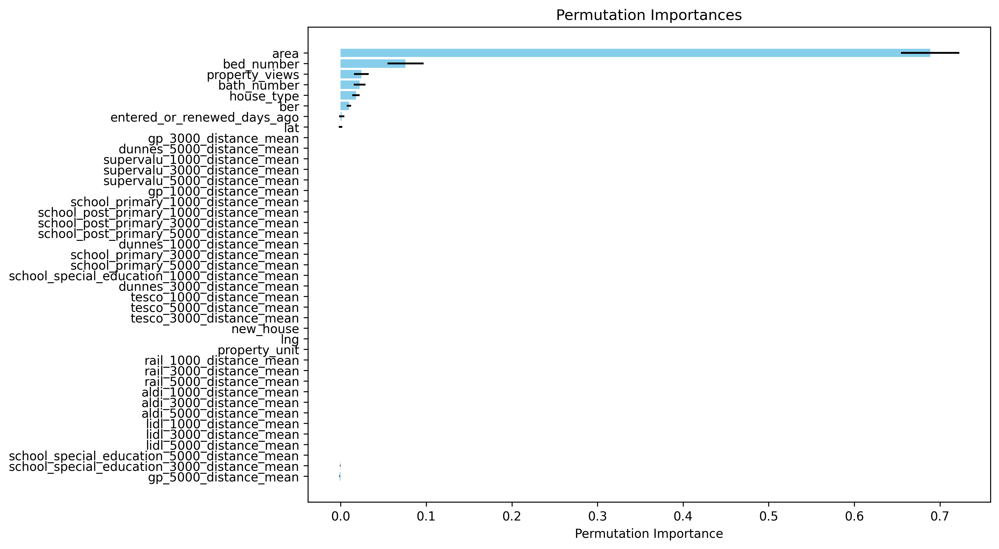

                        Feature  Importance  Standard Deviation
2                          area    0.688598            0.034154
0                    bed_number    0.075834            0.021077
6                property_views    0.024263            0.008418
1                   bath_number    0.022283            0.006924
3                    house_type    0.017938            0.004372
5                           ber    0.009752            0.002601
9   entered_or_renewed_days_ago    0.001289            0.003145
7                           lat    0.000087            0.002056
30        gp_3000_distance_mean    0.000000            0.000000
25    dunnes_5000_distance_mean    0.000000            0.000000


In [41]:
from sklearn.inspection import permutation_importance
import numpy as np

# Get the best estimator from GridSearchCV
best_model = lr_grid_search.best_estimator_

# Compute permutation importance
result = permutation_importance(
    best_model,
    X_test,
    y_test,
    n_repeats=10,  # Number of times to permute each feature
    random_state=0,  # For reproducibility
    n_jobs=-1  # Use all available cores
)

# Extract importance values
importances = result.importances_mean
importances_std = result.importances_std

# Get feature names from the ColumnTransformer
feature_names = []
for name, transformer, columns in preprocessor.transformers_:
    if name == 'categorical':
        feature_names.extend(transformer.named_steps['OneHot'].get_feature_names_out(categorical_columns))
    else:
        feature_names.extend(columns)

# Handle cases where feature names might be missing (e.g., due to dimensionality reduction)
if len(feature_names) != len(importances):
    feature_names = [f'Feature_{i}' for i in range(len(importances))]

# Create a DataFrame for visualization
importance_df = pd.DataFrame({
    'Feature': grid_search.feature_names_in_,
    'Importance': importances,
    'Standard Deviation': importances_std
})

# Sort by importance
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Plot feature importances
plt.figure(figsize=(10, 7), dpi=300)
plt.barh(importance_df['Feature'], importance_df['Importance'], xerr=importance_df['Standard Deviation'], color='skyblue')
plt.xlabel('Permutation Importance')
plt.title('Permutation Importances')
plt.gca().invert_yaxis()  # Highest importance at the top

plt.savefig('Metrics/1.permutation importance.jpg', bbox_inches='tight')
plt.show()

# Print feature importances
print(importance_df.head(10))

### Model Coefficients

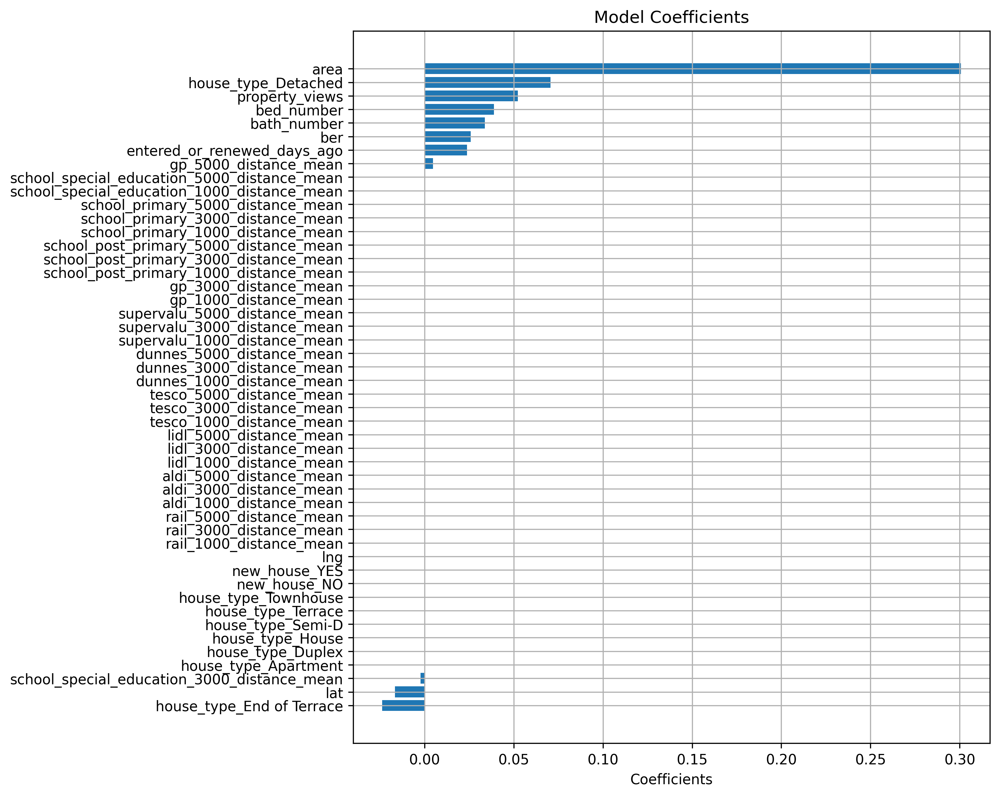

In [42]:
plt.figure(figsize=(10, 8), dpi=300)

# Extract the best model
best_model = lr_grid_search.best_estimator_
preprocessor = best_model.named_steps['preprocessor']
regressor = best_model.named_steps['regressor']
feature_names = feature_name_strip = [name.split('__')[-1] for name in preprocessor.get_feature_names_out()]
features_with_coefs = zip(feature_name_strip, regressor.coef_)

# Sort by coefficients in descending order
sorted_features_with_coefs = sorted(features_with_coefs, key=lambda x: x[1])

# Separate sorted results
sorted_feature_names, sorted_coefs = zip(*sorted_features_with_coefs)

plt.barh(sorted_feature_names, sorted_coefs)
plt.xlabel('Coefficients')
plt.grid(True)
plt.title('Model Coefficients')
plt.tight_layout()
plt.savefig('Metrics/5.linear_coefficients.jpg')
plt.show()

### Residual Plot

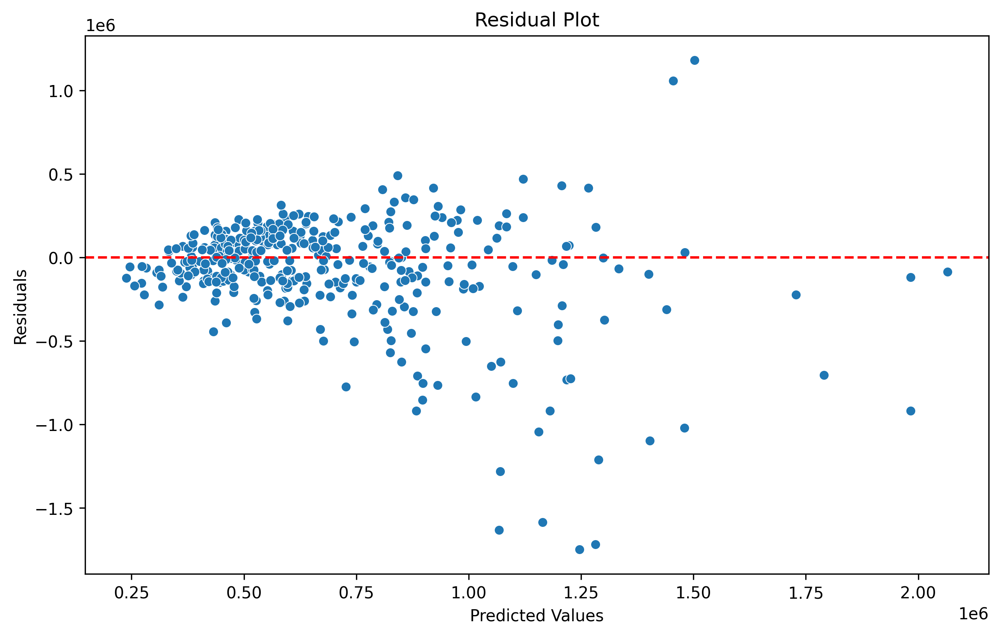

In [43]:
import seaborn as sns

# Calculate residuals
y_test_pred = lr_grid_search.predict(X_test)
residuals = np.expm1(y_test_pred) - np.expm1(y_test)

# Plot residuals
plt.figure(figsize=(10, 6), dpi=300)
sns.scatterplot(x=np.expm1(y_test_pred)-1, y=residuals)
plt.axhline(y=0, color='r', linestyle='--')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.title('Residual Plot')

plt.savefig('Metrics/2.test_set_residual_plot.jpg')
plt.show()

A quick conclusion on the residual plot, with the price goes higher, the prediction become harder and not so accurate.

## Model Explainability with SHAP (SHapley Additive exPlanations)

### Feature Summary Plot

Fitting 5 folds for each of 45 candidates, totalling 225 fits


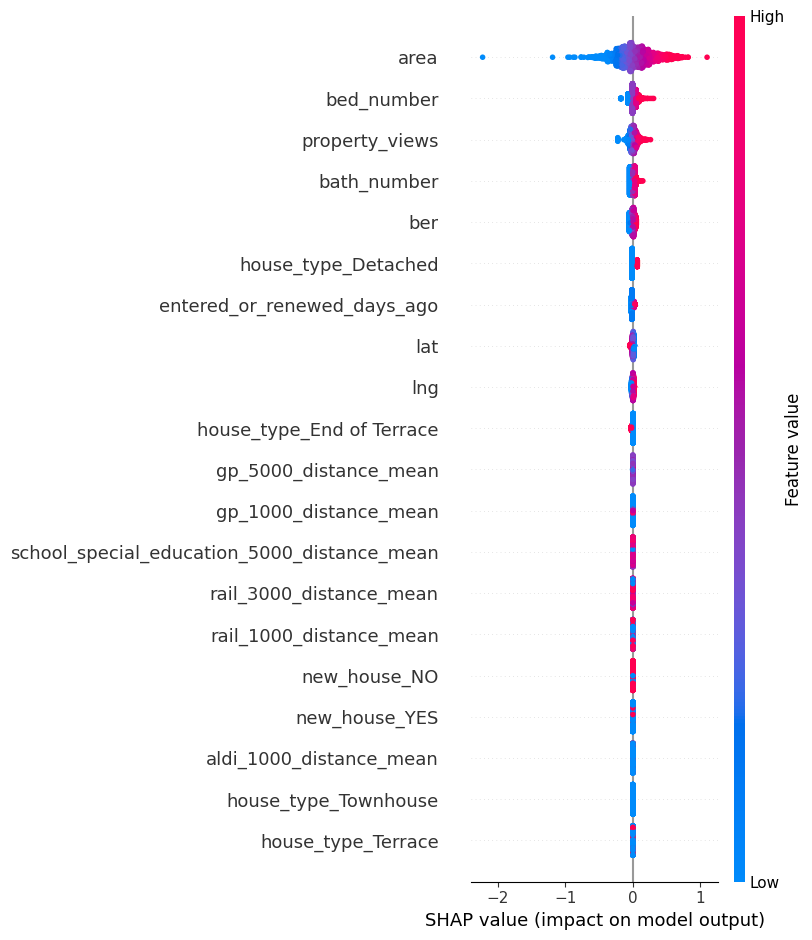

In [44]:
import shap

# Fit the GridSearchCV
lr_grid_search.fit(features, label)

# Extract the best model
best_model = lr_grid_search.best_estimator_

# Extract the preprocessor and fitted regressor
preprocessor = best_model.named_steps['preprocessor']
regressor = best_model.named_steps['regressor']

# Transform the training data
X_train_transformed = preprocessor.transform(X_train)

# Create SHAP explainer for ElasticNet model
explainer = shap.Explainer(regressor, X_train_transformed)
shap_values = explainer(X_train_transformed)

# Get feature names from the preprocessor
feature_names = feature_name_strip = [name.split('__')[-1] for name in preprocessor.get_feature_names_out()]

# Plot SHAP beeswarm summary plot
shap.summary_plot(shap_values, X_train_transformed, feature_names=feature_names, show=False)

# Show the plot
plt.savefig('Metrics/3.shap_summary_plot.jpg', bbox_inches='tight', dpi=300)
plt.show()

### Mean Absolute Price Difference by 10K Bins

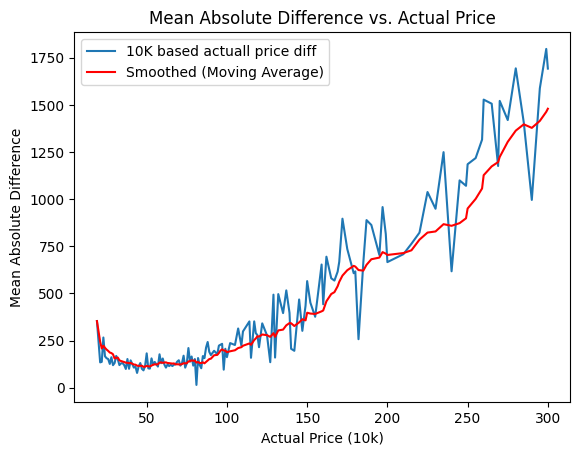

In [45]:
predict_price = lr_grid_search.predict(features)
actual_price = label
price_comparison = pd.DataFrame({
    'predict_price': np.expm1(predict_price) / 1000,
    'actual_price': np.expm1(actual_price) / 1000
})
price_comparison['abs_diff'] = np.abs(price_comparison['predict_price'] - price_comparison['actual_price'])
price_comparison = price_comparison.round(2)
price_comparison = price_comparison.sort_values(by=['actual_price'])
price_comparison['actual_price_10k'] = price_comparison['actual_price'] // 10
price_diff_bins = price_comparison.groupby('actual_price_10k').agg({
    'abs_diff': 'mean'
})
# price_diff_bins
plt.plot(price_diff_bins.index, price_diff_bins['abs_diff'], label='10K based actuall price diff')

# Calculate moving average with a window size (e.g., 10)
window_size = 10
price_diff_bins['abs_diff_smoothed'] = price_diff_bins['abs_diff'].rolling(window=window_size, min_periods=1).mean()
plt.plot(price_diff_bins.index, price_diff_bins['abs_diff_smoothed'], label='Smoothed (Moving Average)', color='red')
plt.xlabel('Actual Price (10k)')
plt.ylabel('Mean Absolute Difference')
plt.title('Mean Absolute Difference vs. Actual Price')
plt.legend()

plt.savefig('Metrics/4.price_diff_bin_10k.jpg', dpi=300)
plt.show()

In [46]:
lower_price, upper_price = 400, 650
medium_range = price_comparison[price_comparison['actual_price'].between(lower_price, upper_price)]
medium_range_mape = np.sum(medium_range['abs_diff'] / medium_range['actual_price']) / len(medium_range)
mean_price_diff = medium_range['abs_diff'].mean()
print(f'For house price between {lower_price}K to {upper_price}K, mean price difference: {mean_price_diff :.2f}K, and mean absolute percentage error (MAPE): {medium_range_mape*100 :.2f}%.')


For house price between 400K to 650K, mean price difference: 117.26K, and mean absolute percentage error (MAPE): 22.91%.


### Test Example

In [47]:
sample_test = source[source['address'] == '23 Stapolin Avenue, The Coast, Baldoyle, Dublin 13, D13PD6F']
sample_test[['property_views', 'area', 'price']]

,property_views,area,price
1430,3381,166.0,640000.0


In [48]:
sample_index = features[(features['area'] == 166) & (features['property_views'] == 3381)].index
np.expm1(predict_price[sample_index][0])

737798.1676584785

In [49]:
sample_predict_price = np.expm1(predict_price[sample_index][0])
sample_actual_price = sample_test['price']
mape = (sample_predict_price - sample_actual_price) / sample_actual_price * 100

print(f'mape: {mape.values[0] :.2f}%')

mape: 15.28%


#### Increase 1 square meters on area, or 1 bedroom, or 1 bathroom, what will the price change?

In [50]:
increase_unit = 1
predict_price = lr_grid_search.predict(features)
test_list = ['area', 'bed_number', 'bath_number', 'ber']
for test_item in test_list:
    temp = features.copy()
    temp[test_item] += increase_unit # increare increase_unit unit for each test item
    temp_price = lr_grid_search.predict(temp)
    mean_price_diff = np.mean(np.expm1(temp_price) - np.expm1(predict_price))
    trend = 'increase' if mean_price_diff > 0 else 'decrease'
    print(f'Increase {increase_unit} unit on {test_item}, the price will {trend} {mean_price_diff/1000 :.2f}K euros.')

Increase 1 unit on area, the price will increase 2.86K euros.
Increase 1 unit on bed_number, the price will increase 44.49K euros.
Increase 1 unit on bath_number, the price will increase 23.66K euros.
Increase 1 unit on ber, the price will increase 4.51K euros.
